# 📊 Pipeline d'Analyse Complète des Images Raman
## Clustering Multi-Paramètres (Taille × Forme × Intensité)

**Projet**: Analyse morphologique et chimique de particules via spectroscopie 

---
### 📋 Sections du Notebook
1. ✅ Import des Bibliothèques et Chargement de l'Image
2. 📊 Évaluation de la Qualité de l'Image
3. 🔬 Prétraitement et Segmentation par Intensité
4. 🔍 Détection et Extraction des Particules
5. 🎯 Clustering Multi-Paramètres (Taille × Forme × Intensité)
6. 📐 Clustering 3D et Classification Physique
7. 📈 Analyse PCA et Réduction Dimensionnelle
8. 🏆 Identification de la Zone Équilibrée Représentative
9. 📊 Visualisations Avancées et Heatmaps
10. 📋 Rapport Final et Sauvegarde des Résultats

## 1️⃣ Import des Bibliothèques et Chargement de l'Image

In [1]:
# Import des bibliothèques essentielles
import cv2
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from scipy.stats import entropy
from scipy.ndimage import gaussian_filter
from skimage import morphology, measure
import warnings

warnings.filterwarnings('ignore')

print("✓ Toutes les bibliothèques importées avec succès")


✓ Toutes les bibliothèques importées avec succès


In [2]:
# Charger l'image Raman
image_path = "C:\\Users\\marwa\\OneDrive\\Desktop\\Analyse_Raman\\Spectroscopie optique\\Spectroscopie optique\\08_x100_Pol_SansStack_coaxLight.tif"

# Support .jpg / .tif / .tiff
candidate_paths = [image_path]
if image_path.lower().endswith(".jpg"):
    candidate_paths.append(image_path[:-4] + ".tif")
    candidate_paths.append(image_path[:-4] + ".tiff")

img = None
for path in candidate_paths:
    img = cv2.imread(path)
    if img is not None:
        image_path = path
        break

if img is not None:
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
else:
    raise FileNotFoundError(f"L'image n'a pas pu être chargée: {candidate_paths}")

print(f"📷 Image chargée: {gray.shape}")
print(f"   Dimensions: {img_rgb.shape[1]} × {img_rgb.shape[0]} pixels")
print(f"   Type de données: {gray.dtype}")

📷 Image chargée: (1536, 2048)
   Dimensions: 2048 × 1536 pixels
   Type de données: uint8


In [3]:
# ====================================================================
# 1. ⚙️ CONFIGURATION PHYSIQUE (LE SEUL ENDROIT À TOUCHER)
# ====================================================================
# Paramètres de l'image (Mesurés précédemment)
SCALE_BAR_VALUE_UM = 100     # La valeur écrite sur la barre (en µm)
SCALE_BAR_LENGTH_PX = 98    # <--- VOTRE MESURE (ex: 165 ou 284 px)

# Paramètres de nettoyage (Qu'est-ce qui est du bruit ?)
MIN_DIAMETER_UM = 0.5        # On ignore tout ce qui est plus petit que 0.5 µm (poussière)

# --- CALCUL AUTOMATIQUE DES FACTEURS DE CONVERSION ---
PX_TO_UM = SCALE_BAR_VALUE_UM / SCALE_BAR_LENGTH_PX
PX_AREA_TO_UM2 = PX_TO_UM ** 2

# Calcul du seuil de nettoyage en pixels
min_area_um2 = math.pi * ((MIN_DIAMETER_UM / 2) ** 2)
MIN_AREA_PX = int(min_area_um2 / PX_AREA_TO_UM2)

print(f"📏 CALIBRATION ACTIVÉE :")
print(f"   • 1 pixel = {PX_TO_UM:.4f} µm")
print(f"   • 1 pixel² = {PX_AREA_TO_UM2:.4f} µm²")
print(f"   • Seuil de bruit : < {MIN_DIAMETER_UM} µm (soit < {MIN_AREA_PX} pixels)")
print("="*70)

📏 CALIBRATION ACTIVÉE :
   • 1 pixel = 1.0204 µm
   • 1 pixel² = 1.0412 µm²
   • Seuil de bruit : < 0.5 µm (soit < 0 pixels)


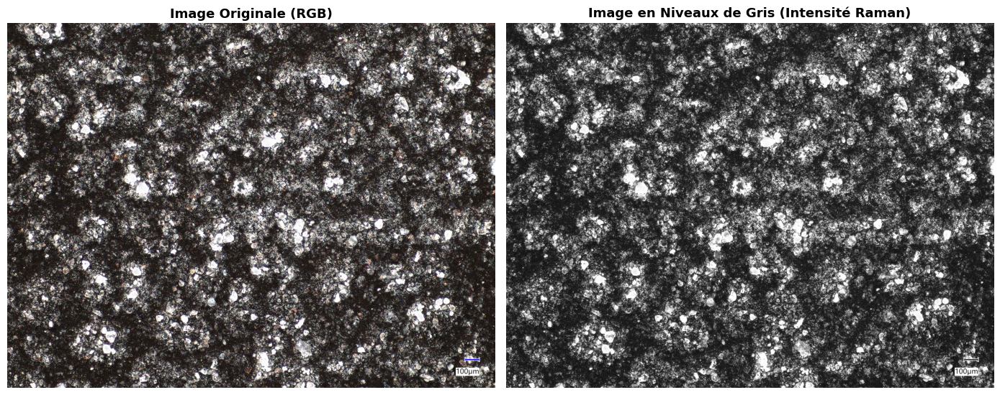

✓ Image affichée pour validation


In [4]:
# Affichage côte à côte
plt.figure(figsize=(14, 6))

# image originale en RGB
plt.subplot(1, 2, 1)
plt.imshow(img_rgb)
plt.title("Image Originale (RGB)", fontsize=13, fontweight='bold')
plt.axis("off")

# image originale en niveaux de gris
plt.subplot(1, 2, 2)
plt.imshow(gray, cmap="gray")
plt.title("Image en Niveaux de Gris (Intensité Raman)", fontsize=13, fontweight='bold')
plt.axis("off")

plt.tight_layout()
plt.show()

print("✓ Image affichée pour validation")

## 2️⃣ Évaluation de la Qualité de l'Image

In [5]:
print("\n📊 QUALITÉ DE L'IMAGE (avant prétraitement):")
print("="*70)

# Métrique 1: Contraste
contrast = np.std(gray)
print(f"  • Contraste (écart-type): {contrast:.2f}")

# Métrique 2: Plage dynamique (de 0 à 255)
dynamic_range = gray.max() - gray.min()
print(f"  • Plage dynamique: {dynamic_range} (min: {gray.min()}, max: {gray.max()})")

# Métrique 3: Netteté (variance du Laplacien)
laplacian = cv2.Laplacian(gray, cv2.CV_64F)
sharpness = laplacian.var()
print(f"  • Netteté (variance Laplacien): {sharpness:.2f}")

# Métrique 4: Rapport signal/bruit estimé (SNR)
mean_intensity = gray.mean()
std_intensity = gray.std()
snr_estimate = mean_intensity / std_intensity if std_intensity > 0 else 0
print(f"  • SNR estimé: {snr_estimate:.2f}")

# Métrique 5: Entropie (niveau d'information)
hist, _ = np.histogram(gray.ravel(), bins=256, range=(0, 256))
hist_normalized = hist / hist.sum()
image_entropy = entropy(hist_normalized + 1e-10)
print(f"  • Entropie: {image_entropy:.2f}")

# Métrique 6: Coefficient de variation (CV)
cv = (std_intensity / mean_intensity) * 100 if mean_intensity > 0 else 0
print(f"  • Coefficient de variation: {cv:.2f}%")

print(f"\n✓ Qualité image évaluée")


📊 QUALITÉ DE L'IMAGE (avant prétraitement):
  • Contraste (écart-type): 66.54
  • Plage dynamique: 255 (min: 0, max: 255)
  • Netteté (variance Laplacien): 16295.52
  • SNR estimé: 1.22
  • Entropie: 5.22
  • Coefficient de variation: 81.74%

✓ Qualité image évaluée


In [6]:
# ====================================================================
# 📊 QUALITÉ DE L'IMAGE AVANCÉE (Spécial Microscopie Fond Sombre)
# ====================================================================
print("\n📊 DIAGNOSTIC QUALITÉ IMAGE")
print("="*70)

# Import nécessaire pour le skewness (asymétrie de l'histogramme)
from scipy.stats import skew

# --- 1. ANALYSE DE L'EXPOSITION (Saturation) ---
# On vérifie si on perd des infos dans le noir total ou le blanc total
pixels_total = gray.size
saturated_low = np.sum(gray == 0) / pixels_total * 100
saturated_high = np.sum(gray == 255) / pixels_total * 100

print(f"1. EXPOSITION & DYNAMIQUE :")
print(f"   • Plage utilisée : {gray.min()} à {gray.max()} (Idéal: 0-255)")
if saturated_high > 5:
    print(f"   ⚠️ ATTENTION : {saturated_high:.1f}% de pixels saturés (blancs). Éclairage trop fort ?")
elif saturated_low > 50:
    print(f"   ℹ️ Note : {saturated_low:.1f}% de pixels noirs purs (Normal pour fond sombre)")
else:
    print(f"   ✓ Exposition équilibrée.")

# --- 2. ANALYSE DU FOND (Bruit) ---
# En fond sombre, le mode (pic de l'histo) correspond au fond.
# On estime le bruit en regardant la largeur de ce pic.
background_level = np.median(gray)
# On prend les pixels inférieurs à la médiane pour estimer le bruit du fond sans les particules
noise_floor = gray[gray <= background_level].std()

print(f"\n2. FOND & BRUIT (Background) :")
print(f"   • Niveau moyen du fond : {background_level:.1f}/255")
print(f"   • Bruit de fond (Noise Floor) : {noise_floor:.2f}")

if noise_floor > 10:
    print("   ⚠️ BRUIT ÉLEVÉ : Le fond n'est pas net. Risque de fausses détections.")
elif noise_floor < 2:
    print("   ✓ Fond très propre (peu de bruit caméra).")
else:
    print("   ✓ Bruit acceptable.")

# --- 3. CONTRASTE UTILE (Signal-to-Background Ratio - SBR) ---
# On compare les particules (Top 1% brillants) au fond (Médiane)
signal_level = np.percentile(gray, 99) # Intensité des particules les plus brillantes
contrast_ratio = signal_level / (background_level + 1e-5)

print(f"\n3. CONTRASTE PARTICULES (Signal/Fond) :")
print(f"   • Intensité Particules (Top 1%) : {signal_level:.1f}")
print(f"   • Ratio Contrast (SBR) : {contrast_ratio:.1f}")

if contrast_ratio < 2.0:
    print("   ⚠️ CONTRASTE FAIBLE : Difficile de séparer les particules du fond.")
elif contrast_ratio > 5.0:
    print("   ✓ Contraste Excellent : Segmentation facile.")
else:
    print("   ✓ Contraste Moyen.")

# --- 4. NETTETÉ (Focus) ---
# Variance du Laplacien (classique mais efficace)
laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()
print(f"\n4. NETTETÉ (Focus Score) : {laplacian_var:.1f}")
if laplacian_var < 100:
    print("   ⚠️ IMAGE FLOU ? Score faible (vérifiez la mise au point).")
elif laplacian_var > 500:
    print("   ✓ Image bien nette.")

print("-" * 70)


📊 DIAGNOSTIC QUALITÉ IMAGE
1. EXPOSITION & DYNAMIQUE :
   • Plage utilisée : 0 à 255 (Idéal: 0-255)
   ✓ Exposition équilibrée.

2. FOND & BRUIT (Background) :
   • Niveau moyen du fond : 59.0/255
   • Bruit de fond (Noise Floor) : 16.05
   ⚠️ BRUIT ÉLEVÉ : Le fond n'est pas net. Risque de fausses détections.

3. CONTRASTE PARTICULES (Signal/Fond) :
   • Intensité Particules (Top 1%) : 255.0
   • Ratio Contrast (SBR) : 4.3
   ✓ Contraste Moyen.

4. NETTETÉ (Focus Score) : 16295.5
   ✓ Image bien nette.
----------------------------------------------------------------------


## 3️⃣ Prétraitement et Segmentation par Intensité

In [7]:
# 1. PRÉTRAITEMENT "Remplissage" (La méthode chirurgicale, pilotée par la physique)
from skimage.morphology import remove_small_objects as sk_remove_small_objects
_ = None  # variable neutre si nécessaire

# On reprend l'image originale
blur = cv2.GaussianBlur(gray, (3, 3), 0)

# A. Détection sensible (paramètres conservés)
# Block Size = 15, C = 2 (Réglages initiaux qui marchaient bien)
binary = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, 
                               cv2.THRESH_BINARY, 15, 2)

# B. Nettoyage initial (petite ouverture pour enlever le bruit très fin)
kernel = np.ones((3,3), np.uint8)
binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel, iterations=1)

# C. L'ASTUCE MAGIQUE : Remplissage des trous (Hole Filling)
# On détecte les contours et on remplit l'intérieur en blanc pour transformer
# les "donuts" (cristaux creux) en particules pleines.
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
binary_filled = np.zeros_like(binary)
cv2.drawContours(binary_filled, contours, -1, 255, cv2.FILLED)

# --- D. NETTOYAGE RENFORCÉ PILOTÉ PAR LA CALIBRATION ---

# 1. Ouverture modérée pour casser les petites connexions de bruit
kernel_clean = np.ones((3,3), np.uint8)
binary_clean = cv2.morphologyEx(binary_filled, cv2.MORPH_OPEN, kernel_clean, iterations=1)

# 2. Filtre de taille basé sur la physique (MIN_AREA_PX issu de la barre d'échelle)
min_area_noise = MIN_AREA_PX

print(f"🧹 Suppression des objets < {min_area_um2:.1f} µm² (≈ {MIN_AREA_PX} pixels)...")

clean = sk_remove_small_objects(binary_clean.astype(bool), min_size=min_area_noise)
clean = clean.astype(np.uint8) * 255

# La suite (Watershed) utilise maintenant un masque déjà filtré physiquement.

print(f"✓ Nettoyage terminé (Seuil taille : {min_area_noise} px, {min_area_um2:.1f} µm²).")

🧹 Suppression des objets < 0.2 µm² (≈ 0 pixels)...
✓ Nettoyage terminé (Seuil taille : 0 px, 0.2 µm²).


🔬 Nombre de particules : 4567


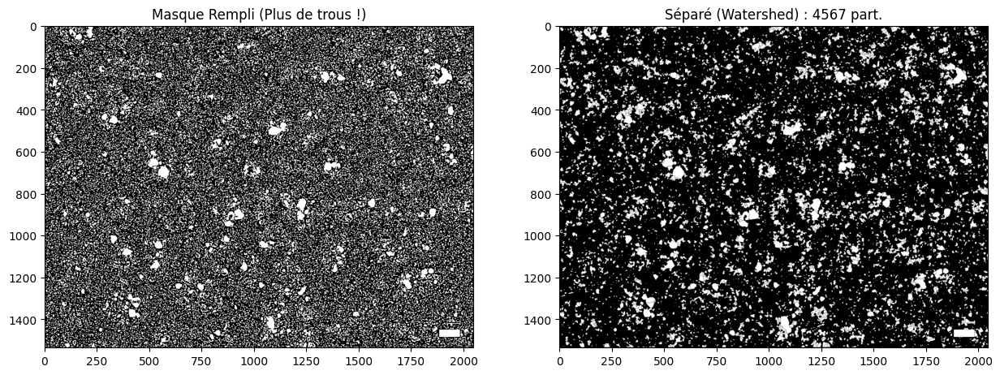

In [8]:
# 2. SÉPARATION (WATERSHED)
# On reprend les réglages standards mais avec un seuil ajusté pour éviter la sur-segmentation
dist_transform = cv2.distanceTransform(clean, cv2.DIST_L2, 5)

# On utilise un seuil autour de 5% pour séparer proprement les particules
ret, sure_fg = cv2.threshold(dist_transform, 0.1 * dist_transform.max(), 255, 0)
sure_fg = np.uint8(sure_fg)

# Arrière-plan sûr obtenu par dilatation du masque nettoyé physiquement
sure_bg = cv2.dilate(clean, kernel_clean, iterations=3)
unknown = cv2.subtract(sure_bg, sure_fg)

ret, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 255] = 0

img_color_fake = cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR)
markers = cv2.watershed(img_color_fake, markers)

clean_separated = np.zeros_like(clean, dtype=np.uint8)
clean_separated[markers > 1] = 255

# 3. RÉSULTAT
labels = measure.label(clean_separated)
num_particles = labels.max()
print(f"🔬 Nombre de particules : {num_particles}")

# Affichage pour confirmer
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
plt.title("Masque Rempli (Plus de trous !)")
plt.imshow(clean, cmap='gray')
plt.subplot(1, 2, 2)
plt.title(f"Séparé (Watershed) : {num_particles} part.")
plt.imshow(clean_separated, cmap='gray')
plt.show()

## 4️⃣ Détection et Extraction des Particules

In [9]:
# Détecter et extraire les features de TOUTES les particules en une seule passe
def detect_all_particles(clean_mask, gray_original, min_area=10):
    """Détecter et extraire les features de toutes les particules
    
    Args:
        clean_mask: Masque binaire après Watershed (séparé)
        gray_original: Image originale en niveaux de gris (NON CLAHE) pour intensité réelle
        min_area: Aire minimale (réduite car particules séparées)
    """
    # Trouver les contours du masque nettoyé
    contours, _ = cv2.findContours(clean_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    features = []
    valid_contours = []
    
    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area < min_area:
            continue
        
        # Extraire les features géométriques de base
        perimeter = cv2.arcLength(cnt, True)
        circularity = (4 * np.pi * area) / (perimeter**2 + 1e-6)
        
        x, y, w, h = cv2.boundingRect(cnt)
        aspect_ratio = w / h if h > 0 else 0
        
        hull = cv2.convexHull(cnt)
        hull_area = cv2.contourArea(hull)
        solidity = area / hull_area if hull_area > 0 else 0
        
        # Conversion physique immédiate de l'aire
        area_um2 = area * PX_AREA_TO_UM2
        log_area_um2 = np.log1p(area_um2)
        
        # ⚠️ IMPORTANT: Intensité mesurée sur l'image ORIGINALE, pas CLAHE
        mask_particle = np.zeros_like(gray_original, dtype=np.uint8)
        cv2.drawContours(mask_particle, [cnt], -1, 255, -1)
        mean_intensity = cv2.mean(gray_original, mask=mask_particle)[0]
        
        # Calculer le centroïde
        M = cv2.moments(cnt)
        if M['m00'] > 0:
            center_x = int(M['m10'] / M['m00'])
            center_y = int(M['m01'] / M['m00'])
        else:
            center_x = x + w // 2
            center_y = y + h // 2
        
        features.append({
            'Area_px2': area,
            'Area_um2': area_um2,
            'Log_Area_um2': log_area_um2,
            'Perimeter_px': perimeter,
            'Circularity': circularity,
            'AspectRatio': aspect_ratio,
            'Solidity': solidity,
            'MeanIntensity': mean_intensity,
            'Center_X': center_x,
            'Center_Y': center_y
        })
        valid_contours.append(cnt)
    
    return features, valid_contours


"""
============================================
Détecter et extraire les particules
============================================
"""
print("🔍 Détection de TOUTES les particules (sur masque séparé)...\n")

# ⚠️ IMPORTANT: 
# - Utiliser clean_separated (après Watershed) pour détecter les contours
# - Utiliser gray (image originale) pour mesurer l'intensité réelle
all_features, all_contours = detect_all_particles(clean_separated, gray, min_area=10)
df_particles = pd.DataFrame(all_features)

print(f"✓ Total particules détectées: {len(df_particles)}")
print(f"  Intensité moyenne (globale): {df_particles['MeanIntensity'].mean():.1f}/255")
print(f"  Intensité min/max: {df_particles['MeanIntensity'].min():.1f} / {df_particles['MeanIntensity'].max():.1f}")
print(f"  Aire moyenne: {df_particles['Area_um2'].mean():.2f} µm² (log: {df_particles['Log_Area_um2'].mean():.2f})")

🔍 Détection de TOUTES les particules (sur masque séparé)...

✓ Total particules détectées: 2829
  Intensité moyenne (globale): 138.3/255
  Intensité min/max: 27.4 / 251.4
  Aire moyenne: 165.78 µm² (log: 4.05)


In [10]:
# Statistiques globales des particules
print("\n📊 STATISTIQUES GLOBALES DES PARTICULES:")
print("="*70)

print(f"\nNombre total de particules: {len(df_particles)}")
print(f"\nSurface:")
print(f"  Moyenne: {df_particles['Area_px2'].mean():.1f} ± {df_particles['Area_px2'].std():.1f} px²")
print(f"  Min/Max: {df_particles['Area_px2'].min():.0f} / {df_particles['Area_px2'].max():.0f} px²")

print(f"\nCircularité:")
print(f"  Moyenne: {df_particles['Circularity'].mean():.3f} ± {df_particles['Circularity'].std():.3f}")

print(f"\nSolidité:")
print(f"  Moyenne: {df_particles['Solidity'].mean():.3f}")

print(f"\nIntensité (MeanIntensity):")
print(f"  Moyenne: {df_particles['MeanIntensity'].mean():.1f}/255")
print(f"  Min/Max: {df_particles['MeanIntensity'].min():.1f} / {df_particles['MeanIntensity'].max():.1f}")

print(f"\nAspectRatio:")
print(f"  Moyenne: {df_particles['AspectRatio'].mean():.3f}")



📊 STATISTIQUES GLOBALES DES PARTICULES:

Nombre total de particules: 2829

Surface:
  Moyenne: 159.2 ± 442.6 px²
  Min/Max: 10 / 7273 px²

Circularité:
  Moyenne: 0.419 ± 0.163

Solidité:
  Moyenne: 0.715

Intensité (MeanIntensity):
  Moyenne: 138.3/255
  Min/Max: 27.4 / 251.4

AspectRatio:
  Moyenne: 1.078



🔥 Génération de la heatmap 2D des particules détectées...


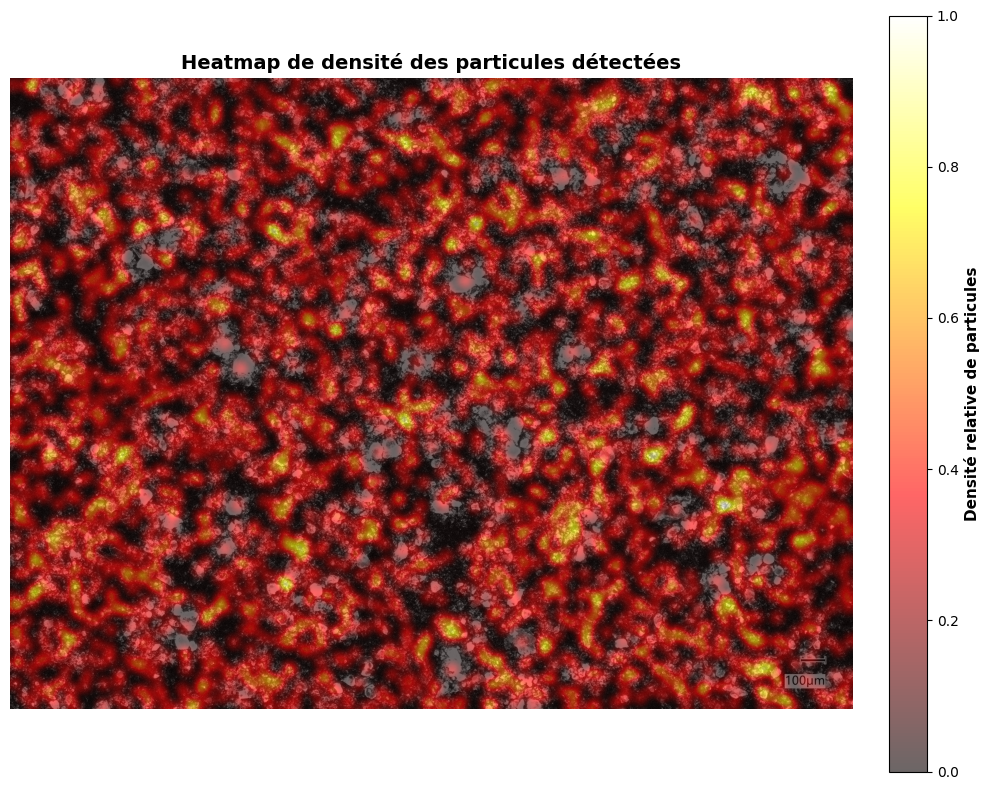

✓ Heatmap 2D des particules générée


In [11]:
# Heatmap 2D des particules détectées
print("\n🔥 Génération de la heatmap 2D des particules détectées...")

import numpy as np
from scipy.ndimage import gaussian_filter

# S'assurer que l'image en niveaux de gris existe
if 'gray' not in globals():
    gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

height, width = gray.shape
heatmap = np.zeros((height, width), dtype=np.float32)

# Ajouter un "blob" autour du centre de chaque particule
rayon = 25  # rayon en pixels autour du centre
for _, row in df_particles.iterrows():
    x, y = int(row['Center_X']), int(row['Center_Y'])
    if x < 0 or x >= width or y < 0 or y >= height:
        continue
    y_min, y_max = max(0, y - rayon), min(height, y + rayon)
    x_min, x_max = max(0, x - rayon), min(width, x + rayon)
    
    for yy in range(y_min, y_max):
        for xx in range(x_min, x_max):
            dist = np.sqrt((xx - x)**2 + (yy - y)**2)
            if dist < rayon:
                weight = np.exp(-(dist**2) / (2 * (rayon/2)**2))
                heatmap[yy, xx] += weight

# Lisser la carte pour un rendu plus propre
heatmap_smooth = gaussian_filter(heatmap, sigma=5)

# Normaliser entre 0 et 1 pour l'affichage
if heatmap_smooth.max() > 0:
    heatmap_norm = heatmap_smooth / heatmap_smooth.max()
else:
    heatmap_norm = heatmap_smooth

fig, ax = plt.subplots(figsize=(10, 8))
ax.imshow(gray, cmap='gray')
im = ax.imshow(heatmap_norm, cmap='hot', alpha=0.6, interpolation='bilinear')
ax.set_title('Heatmap de densité des particules détectées', fontsize=14, fontweight='bold')
ax.axis('off')
cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Densité relative de particules', fontsize=11, fontweight='bold')

plt.tight_layout()
plt.show()

print("✓ Heatmap 2D des particules générée")


🔍 GÉNÉRATION DE L'IMAGE DE PREUVE...


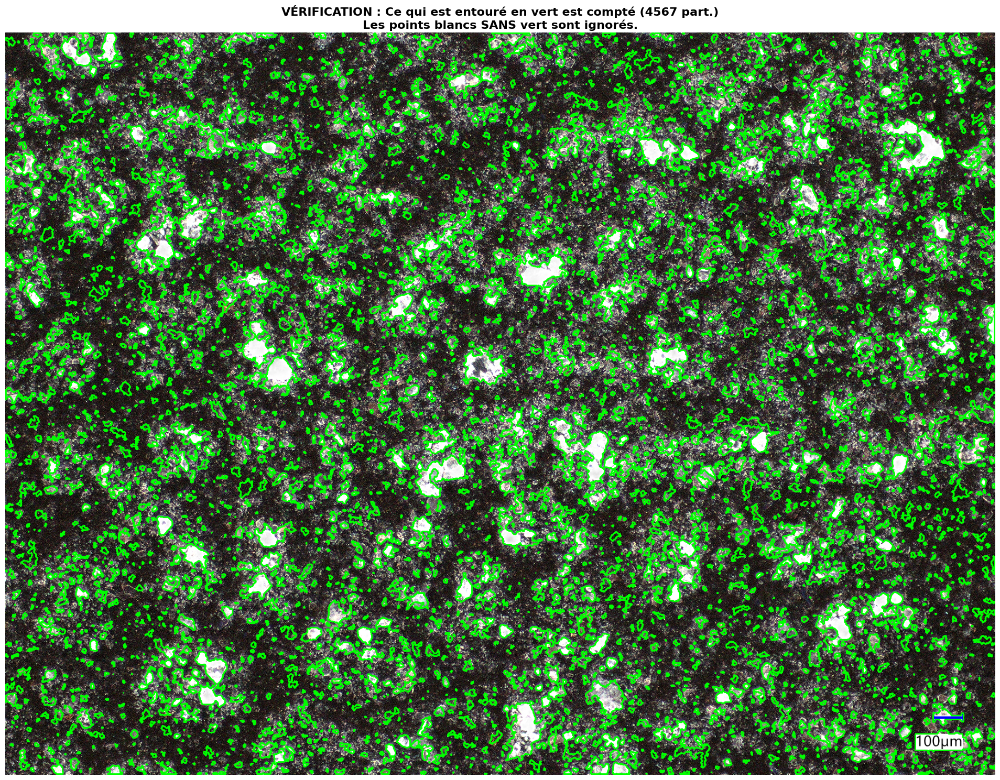

Regardez l'image 'verification_overlay.jpg' :
👉 Si vous voyez beaucoup de cristaux blancs SANS contour vert -> Le filtre est trop fort.
👉 Si les contours verts entourent du vide/noir -> Le seuil est trop bas.


In [12]:
# =======================================================
# 🔍 VÉRIFICATION VISUELLE (OVERLAY)
# =======================================================
print("\n🔍 GÉNÉRATION DE L'IMAGE DE PREUVE...")

# 1. Recharger l'image couleur originale
img_verif = cv2.imread(image_path)
img_verif = cv2.cvtColor(img_verif, cv2.COLOR_BGR2RGB)  # Pour matplotlib

# 2. Trouver les contours du masque FINAL (clean_separated = particules gardées)
contours_final, _ = cv2.findContours(
    clean_separated.astype(np.uint8),
    cv2.RETR_EXTERNAL,
    cv2.CHAIN_APPROX_SIMPLE
)

# 3. Dessiner les contours en VERT (épaisseur 2) sur l'image originale
# Si une particule blanche n'a PAS de contour vert, elle a été filtrée.
cv2.drawContours(img_verif, contours_final, -1, (0, 255, 0), 2)

# 4. Affichage grand format + sauvegarde
plt.figure(figsize=(20, 15))
plt.imshow(img_verif)
plt.title(
    f"VÉRIFICATION : Ce qui est entouré en vert est compté ({len(contours_final)} part.)\n"
    "Les points blancs SANS vert sont ignorés.",
    fontsize=16,
    fontweight='bold'
)
plt.axis('off')
plt.tight_layout()
plt.savefig("verification_overlay.jpg", dpi=300)  # Sauvegarde haute qualité
plt.show()

print("Regardez l'image 'verification_overlay.jpg' :")
print("👉 Si vous voyez beaucoup de cristaux blancs SANS contour vert -> Le filtre est trop fort.")
print("👉 Si les contours verts entourent du vide/noir -> Le seuil est trop bas.")

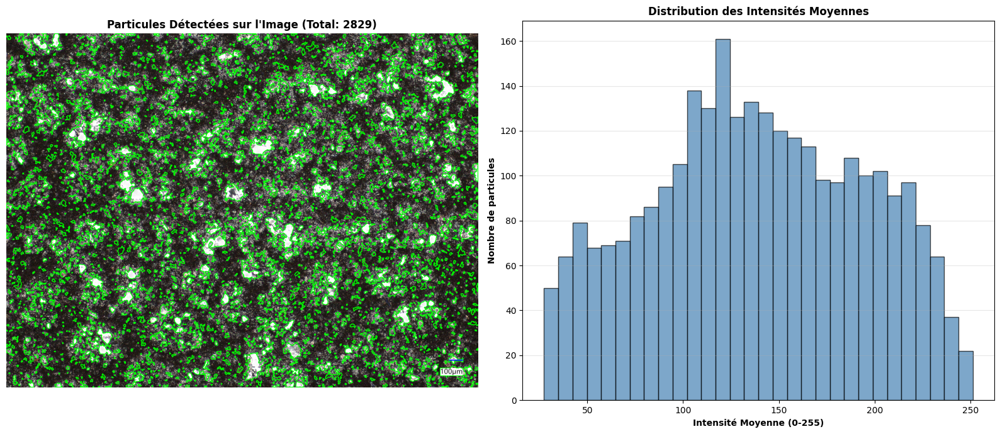

✓ Particules visualisées sur l'image


In [13]:
# Visualiser les particules détectées sur l'image
overlay = img_rgb.copy()
for cnt in all_contours:
    cv2.drawContours(overlay, [cnt], -1, (0, 255, 0), 2)  # Vert - contours

fig, axes = plt.subplots(1, 2, figsize=(16, 7))

# Image avec contours détectés
axes[0].imshow(overlay)
axes[0].set_title(f'Particules Détectées sur l\'Image (Total: {len(df_particles)})', 
                   fontsize=12, fontweight='bold')
axes[0].axis('off')

# Distribution des intensités moyennes
axes[1].hist(df_particles['MeanIntensity'], bins=30, color='steelblue', 
             edgecolor='black', alpha=0.7)
axes[1].set_xlabel('Intensité Moyenne (0-255)', fontweight='bold')
axes[1].set_ylabel('Nombre de particules', fontweight='bold')
axes[1].set_title('Distribution des Intensités Moyennes', fontsize=12, fontweight='bold')
axes[1].grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.show()

print(f"✓ Particules visualisées sur l'image")

## 5️⃣ Clustering Multi-Paramètres (Taille × Forme × Intensité)


🎯 CLUSTERING SCIENTIFIQUE STANDARD: 6 ÉTAPES

✅ ÉTAPE 1 — Sélection des features pertinentes (en unités physiques)
----------------------------------------------------------------------

Features sélectionnées : ['MeanIntensity', 'Log_Area_um2', 'Circularity', 'Solidity']

Rôle de chaque feature :
  • MeanIntensity    → type chimique (Raman)
  • Log_Area_um2    → taille physique (µm², en échelle log)
  • Circularity      → forme (sphéricité)
  • Solidity         → compacité

  ℹ️  AspectRatio retiré (souvent redondant)

  ✓ Features disponibles : ['MeanIntensity', 'Log_Area_um2', 'Circularity', 'Solidity']

✅ ÉTAPE 2 — Normalisation (StandardScaler)
----------------------------------------------------------------------

Avant normalisation :
  MeanIntensity        : min=   27.3636, max=  251.3521, mean=  138.3165
  Log_Area_um2         : min=    2.4347, max=    8.9325, mean=    4.0547
  Circularity          : min=    0.0549, max=    0.9433, mean=    0.4191
  Solidity             : min

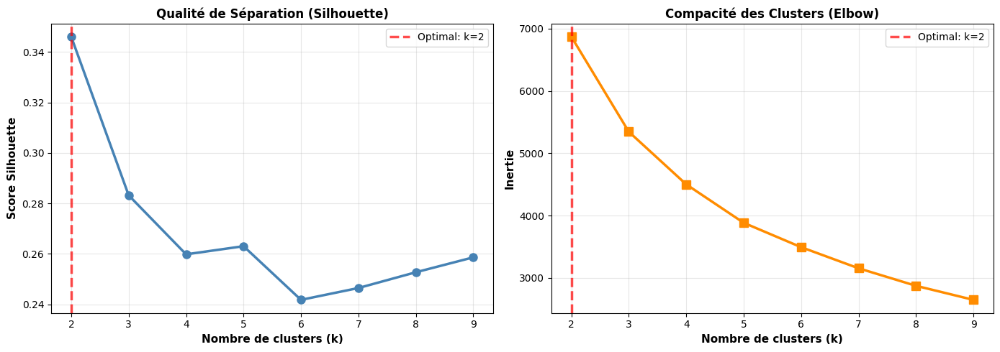


✅ ÉTAPE 4 — Clustering final avec k optimal
----------------------------------------------------------------------

  ✓ KMeans exécuté avec k=2
  ✓ Chaque particule a maintenant un cluster (0 à 1)

  📊 Répartition des clusters:
    Cluster 0: 1148 particules ( 40.6%)
    Cluster 1: 1681 particules ( 59.4%)

  ✅ Total: 2829 particules


In [14]:
print("\n🎯 CLUSTERING SCIENTIFIQUE STANDARD: 6 ÉTAPES")
print("="*70)

if len(df_particles) >= 5:
    # ============================================
    # ✅ ÉTAPE 1 : CHOISIR LES FEATURES UTILES
    # ============================================
    print("\n✅ ÉTAPE 1 — Sélection des features pertinentes (en unités physiques)")
    print("-" * 70)
    
    # Conversion en µm² et log(aire) si nécessaire
    if "Area_um2" not in df_particles.columns:
        df_particles["Area_um2"] = df_particles["Area_px2"] * PX_AREA_TO_UM2
    df_particles["Log_Area_um2"] = np.log1p(df_particles["Area_um2"])
    
    features_cols = [
        "MeanIntensity",
        "Log_Area_um2",
        "Circularity",
        "Solidity"
    ]
    
    print(f"\nFeatures sélectionnées : {features_cols}")
    print("\nRôle de chaque feature :")
    print("  • MeanIntensity    → type chimique (Raman)")
    print("  • Log_Area_um2    → taille physique (µm², en échelle log)")
    print("  • Circularity      → forme (sphéricité)")
    print("  • Solidity         → compacité")
    print("\n  ℹ️  AspectRatio retiré (souvent redondant)")
    
    # Vérifier disponibilité des features
    available_features = [f for f in features_cols if f in df_particles.columns]
    print(f"\n  ✓ Features disponibles : {available_features}")
    
    if len(available_features) < len(features_cols):
        missing = [f for f in features_cols if f not in df_particles.columns]
        print(f"  ⚠️  Features manquantes : {missing}")
        features_cols = available_features
    
    # ============================================
    # ✅ ÉTAPE 2 : NORMALISER (TRÈS IMPORTANT)
    # ============================================
    print("\n✅ ÉTAPE 2 — Normalisation (StandardScaler)")
    print("-" * 70)
    
    # Extraire la matrice des features
    X = df_particles[features_cols].values
    
    print(f"\nAvant normalisation :")
    for i, feat in enumerate(features_cols):
        print(f"  {feat:20s} : min={X[:, i].min():10.4f}, max={X[:, i].max():10.4f}, mean={X[:, i].mean():10.4f}")
    
    # Normaliser avec StandardScaler (OBLIGATOIRE)
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    
    print(f"\nAprès normalisation (StandardScaler) :")
    for i, feat in enumerate(features_cols):
        print(f"  {feat:20s} : min={X_scaled[:, i].min():10.4f}, max={X_scaled[:, i].max():10.4f}, mean={X_scaled[:, i].mean():10.4f}")
    
    print(f"\n  ✓ Les features sont maintenant sur la même échelle (μ=0, σ=1)")
    
    # ============================================
    # ✅ ÉTAPE 3 : TROUVER LE NOMBRE OPTIMAL K
    # ============================================
    print("\n✅ ÉTAPE 3 — Déterminer le nombre optimal de clusters (k)")
    print("-" * 70)
    
    # On limite k en fonction du nombre de particules (≈ modèle fourni)
    K_range = range(2, min(10, max(3, len(df_particles) // 10)))
    
    print(f"\nTest de k = {min(K_range)} à {max(K_range)}")
    print("\nMéthode : Score de Silhouette (meilleur que Elbow)")
    print("-" * 70)
    
    silhouette_scores = {}
    inertia_scores = {}
    
    for k in K_range:
        km = KMeans(n_clusters=k, random_state=42, n_init=50, max_iter=500)
        labels = km.fit_predict(X_scaled)
        
        # Score de silhouette
        sil_score = silhouette_score(X_scaled, labels)
        silhouette_scores[k] = sil_score
        
        # Inertie (pour info)
        inertia_scores[k] = km.inertia_
        
        print(f"  k={k:2d}  →  Silhouette = {sil_score:.4f}  |  Inertie = {km.inertia_:8.1f}")
    
    # Choisir le k avec le meilleur score Silhouette
    best_k = max(silhouette_scores, key=silhouette_scores.get)
    best_silhouette = silhouette_scores[best_k]
    
    print(f"\n  🎯 k OPTIMAL : {best_k}  (Silhouette = {best_silhouette:.4f})")
    
    # Visualiser les scores
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))
    
    # Graphique Silhouette
    k_vals = list(K_range)
    sil_vals = [silhouette_scores[k] for k in k_vals]
    axes[0].plot(k_vals, sil_vals, 'o-', color='steelblue', linewidth=2.5, markersize=8)
    axes[0].axvline(best_k, color='red', linestyle='--', linewidth=2.5, alpha=0.7, label=f'Optimal: k={best_k}')
    axes[0].set_xlabel('Nombre de clusters (k)', fontweight='bold', fontsize=11)
    axes[0].set_ylabel('Score Silhouette', fontweight='bold', fontsize=11)
    axes[0].set_title('Qualité de Séparation (Silhouette)', fontweight='bold', fontsize=12)
    axes[0].grid(True, alpha=0.3)
    axes[0].legend(fontsize=10)
    axes[0].set_xticks(k_vals)
    
    # Graphique Elbow
    inertia_vals = [inertia_scores[k] for k in k_vals]
    axes[1].plot(k_vals, inertia_vals, 's-', color='darkorange', linewidth=2.5, markersize=8)
    axes[1].axvline(best_k, color='red', linestyle='--', linewidth=2.5, alpha=0.7, label=f'Optimal: k={best_k}')
    axes[1].set_xlabel('Nombre de clusters (k)', fontweight='bold', fontsize=11)
    axes[1].set_ylabel('Inertie', fontweight='bold', fontsize=11)
    axes[1].set_title('Compacité des Clusters (Elbow)', fontweight='bold', fontsize=12)
    axes[1].grid(True, alpha=0.3)
    axes[1].legend(fontsize=10)
    axes[1].set_xticks(k_vals)
    
    plt.tight_layout()
    plt.show()
    
    # ============================================
    # ✅ ÉTAPE 4 : CLUSTERING FINAL
    # ============================================
    print("\n✅ ÉTAPE 4 — Clustering final avec k optimal")
    print("-" * 70)
    
    kmeans = KMeans(n_clusters=best_k, random_state=42, n_init=100, max_iter=1000)
    labels = kmeans.fit_predict(X_scaled)
    
    df_particles["Cluster"] = labels
    
    print(f"\n  ✓ KMeans exécuté avec k={best_k}")
    print(f"  ✓ Chaque particule a maintenant un cluster (0 à {best_k-1})")
    
    # Distribution des clusters
    print(f"\n  📊 Répartition des clusters:")
    cluster_counts = df_particles["Cluster"].value_counts().sort_index()
    
    for cluster_id in sorted(df_particles["Cluster"].unique()):
        count = cluster_counts[cluster_id]
        pct = 100 * count / len(df_particles)
        print(f"    Cluster {cluster_id}: {count:4d} particules ({pct:5.1f}%)")
    
    print(f"\n  ✅ Total: {len(df_particles)} particules")
    
else:
    print("⚠️  Pas assez de particules pour le clustering")



✅ ÉTAPE 5 — Visualisations 2D et 3D
----------------------------------------------------------------------


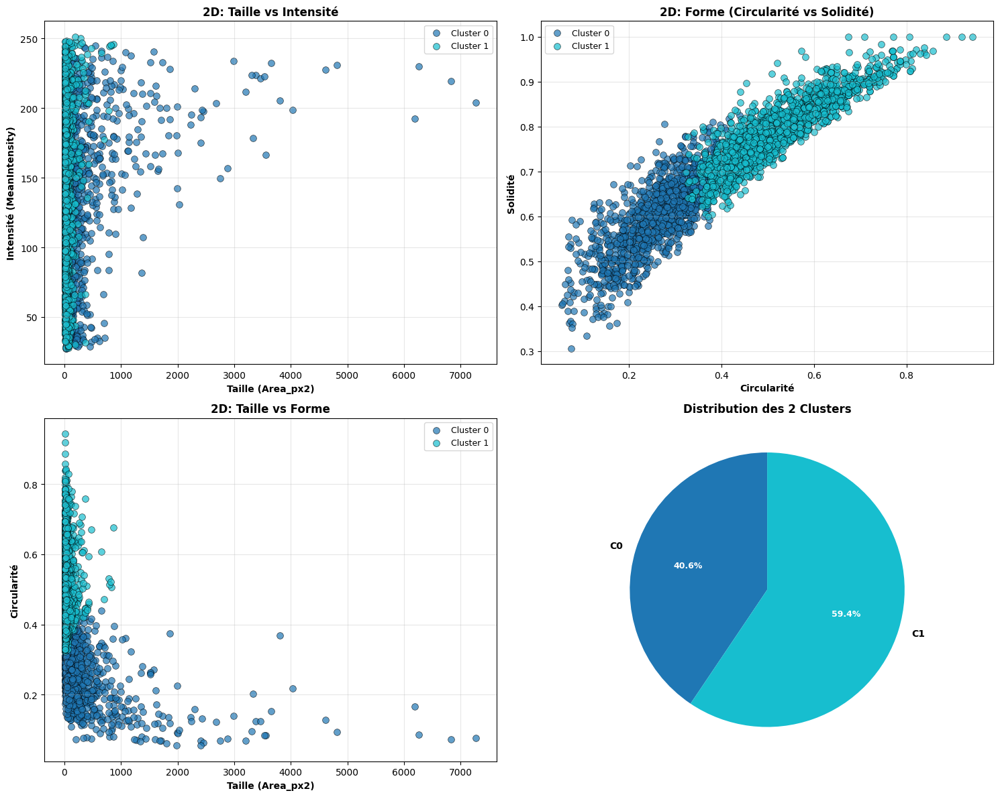


  ✓ Visualisations 2D générées et sauvegardées

  Génération de la visualisation 3D...


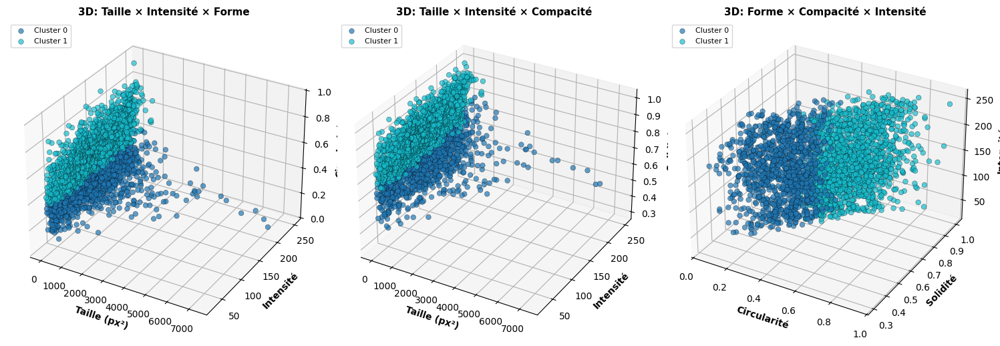


  ✓ Visualisations 3D générées et sauvegardées
  ✓ Les groupes naturels sont maintenant visibles graphiquement


In [15]:

# ============================================
# ✅ ÉTAPE 5 : VISUALISATIONS 2D ET 3D
# ============================================
print("\n✅ ÉTAPE 5 — Visualisations 2D et 3D")
print("-" * 70)

# Palette de couleurs pour les clusters
colors_clusters = plt.cm.tab10(np.linspace(0, 1, best_k))

# === VISUALISATION 2D ===
fig, axes = plt.subplots(2, 2, figsize=(15, 12))

# 2D : Taille vs Intensité
ax = axes[0, 0]
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax.scatter(
        df_particles[mask]["Area_px2"],
        df_particles[mask]["MeanIntensity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=50,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.5
    )
ax.set_xlabel("Taille (Area_px2)", fontweight='bold')
ax.set_ylabel("Intensité (MeanIntensity)", fontweight='bold')
ax.set_title("2D: Taille vs Intensité", fontweight='bold')
ax.legend(fontsize=9, loc='best')
ax.grid(True, alpha=0.3)

# 2D : Circularité vs Solidity
ax = axes[0, 1]
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax.scatter(
        df_particles[mask]["Circularity"],
        df_particles[mask]["Solidity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=50,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.5
    )
ax.set_xlabel("Circularité", fontweight='bold')
ax.set_ylabel("Solidité", fontweight='bold')
ax.set_title("2D: Forme (Circularité vs Solidité)", fontweight='bold')
ax.legend(fontsize=9, loc='best')
ax.grid(True, alpha=0.3)

# 2D : Taille vs Circularité
ax = axes[1, 0]
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax.scatter(
        df_particles[mask]["Area_px2"],
        df_particles[mask]["Circularity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=50,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.5
    )
ax.set_xlabel("Taille (Area_px2)", fontweight='bold')
ax.set_ylabel("Circularité", fontweight='bold')
ax.set_title("2D: Taille vs Forme", fontweight='bold')
ax.legend(fontsize=9, loc='best')
ax.grid(True, alpha=0.3)

# Diagramme circulaire
ax = axes[1, 1]
cluster_counts = df_particles["Cluster"].value_counts().sort_index()
wedges, texts, autotexts = ax.pie(
    cluster_counts,
    labels=[f'C{i}' for i in cluster_counts.index],
    autopct='%1.1f%%',
    colors=colors_clusters,
    startangle=90,
    textprops={'fontsize': 10, 'weight': 'bold'}
)
for autotext in autotexts:
    autotext.set_color('white')
    autotext.set_fontsize(9)
ax.set_title(f"Distribution des {best_k} Clusters", fontweight='bold')

plt.tight_layout()
plt.savefig('clusters_2d_visualization.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n  ✓ Visualisations 2D générées et sauvegardées")

# === VISUALISATION 3D ===
print(f"\n  Génération de la visualisation 3D...")

fig = plt.figure(figsize=(15, 5))

# 3D : Area vs Intensity vs Circularity
ax1 = fig.add_subplot(131, projection='3d')
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax1.scatter(
        df_particles[mask]["Area_px2"],
        df_particles[mask]["MeanIntensity"],
        df_particles[mask]["Circularity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=30,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.3
    )
ax1.set_xlabel("Taille (px²)", fontweight='bold')
ax1.set_ylabel("Intensité", fontweight='bold')
ax1.set_zlabel("Circularité", fontweight='bold')
ax1.set_title("3D: Taille × Intensité × Forme", fontweight='bold', fontsize=11)
ax1.legend(fontsize=8, loc='upper left')

# 3D : Area vs Intensity vs Solidity
ax2 = fig.add_subplot(132, projection='3d')
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax2.scatter(
        df_particles[mask]["Area_px2"],
        df_particles[mask]["MeanIntensity"],
        df_particles[mask]["Solidity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=30,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.3
    )
ax2.set_xlabel("Taille (px²)", fontweight='bold')
ax2.set_ylabel("Intensité", fontweight='bold')
ax2.set_zlabel("Solidité", fontweight='bold')
ax2.set_title("3D: Taille × Intensité × Compacité", fontweight='bold', fontsize=11)
ax2.legend(fontsize=8, loc='upper left')

# 3D : Circularity vs Solidity vs Intensity
ax3 = fig.add_subplot(133, projection='3d')
for cluster_id in sorted(df_particles["Cluster"].unique()):
    mask = df_particles["Cluster"] == cluster_id
    ax3.scatter(
        df_particles[mask]["Circularity"],
        df_particles[mask]["Solidity"],
        df_particles[mask]["MeanIntensity"],
        c=[colors_clusters[cluster_id]],
        label=f"Cluster {cluster_id}",
        s=30,
        alpha=0.7,
        edgecolors='black',
        linewidth=0.3
    )
ax3.set_xlabel("Circularité", fontweight='bold')
ax3.set_ylabel("Solidité", fontweight='bold')
ax3.set_zlabel("Intensité", fontweight='bold')
ax3.set_title("3D: Forme × Compacité × Intensité", fontweight='bold', fontsize=11)
ax3.legend(fontsize=8, loc='upper left')

plt.tight_layout()
plt.savefig('clusters_3d_visualization.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n  ✓ Visualisations 3D générées et sauvegardées")
print(f"  ✓ Les groupes naturels sont maintenant visibles graphiquement")


In [16]:

# ============================================
# ✅ ÉTAPE 6 : SÉPARER LES PARTICULES PAR CLUSTER
# ============================================
print("\n✅ ÉTAPE 6 — Séparation des particules par cluster")
print("-" * 70)

# Méthode 1 : Dictionnaire de clusters
clusters = {}

for c in sorted(df_particles["Cluster"].unique()):
    clusters[c] = df_particles[df_particles["Cluster"] == c]
    
    count = len(clusters[c])
    pct = 100 * count / len(df_particles)
    
    # Statistiques du cluster
    avg_size = clusters[c]["Area_px2"].mean()
    avg_intensity = clusters[c]["MeanIntensity"].mean()
    avg_circ = clusters[c]["Circularity"].mean()
    
    print(f"\n  Cluster {c} : {count} particules ({pct:.1f}%)")
    print(f"    └─ Taille: {avg_size:.0f} px² | Intensité: {avg_intensity:.0f} | Circularité: {avg_circ:.2f}")

print(f"\n  ✓ Dictionnaire 'clusters' créé avec {len(clusters)} clusters")
print(f"    → Accès: clusters[0], clusters[1], etc.")

# Méthode 2 : Variables individuelles (optionnel)
print(f"\n  Ou, créer des variables individuelles :")

for c in sorted(df_particles["Cluster"].unique()):
    var_name = f"cluster_{c}"
    exec(f"{var_name} = df_particles[df_particles.Cluster == {c}]")
    print(f"    → {var_name} = {len(df_particles[df_particles.Cluster == c])} particules")

print(f"\n  ✓ Variables individuelles créées : cluster_0, cluster_1, etc.")

# ============================================
# 📊 RÉSUMÉ STATISTIQUE FINAL
# ============================================
print("\n" + "="*70)
print("📊 RÉSUMÉ STATISTIQUE FINAL")
print("="*70)

summary_data = []

for cluster_id in sorted(df_particles["Cluster"].unique()):
    cluster_data = df_particles[df_particles["Cluster"] == cluster_id]
    
    summary_data.append({
        'Cluster_ID': cluster_id,
        'Count': len(cluster_data),
        'Percentage': f'{100 * len(cluster_data) / len(df_particles):.1f}%',
        'Area_Mean': f'{cluster_data["Area_px2"].mean():.0f}',
        'Area_Std': f'{cluster_data["Area_px2"].std():.0f}',
        'Intensity_Mean': f'{cluster_data["MeanIntensity"].mean():.0f}',
        'Intensity_Std': f'{cluster_data["MeanIntensity"].std():.0f}',
        'Circularity_Mean': f'{cluster_data["Circularity"].mean():.3f}',
        'Solidity_Mean': f'{cluster_data["Solidity"].mean():.3f}',
    })

df_summary = pd.DataFrame(summary_data)

print("\n")
print(df_summary.to_string(index=False))

print(f"\n\n✅ Clustering scientifique complété avec succès!")
print(f"   → {best_k} clusters identifiés")
print(f"   → {len(df_particles)} particules classifiées")
print(f"   → Score Silhouette optimal: {best_silhouette:.4f}")



✅ ÉTAPE 6 — Séparation des particules par cluster
----------------------------------------------------------------------

  Cluster 0 : 1148 particules (40.6%)
    └─ Taille: 324 px² | Intensité: 137 | Circularité: 0.26

  Cluster 1 : 1681 particules (59.4%)
    └─ Taille: 47 px² | Intensité: 139 | Circularité: 0.53

  ✓ Dictionnaire 'clusters' créé avec 2 clusters
    → Accès: clusters[0], clusters[1], etc.

  Ou, créer des variables individuelles :
    → cluster_0 = 1148 particules
    → cluster_1 = 1681 particules

  ✓ Variables individuelles créées : cluster_0, cluster_1, etc.

📊 RÉSUMÉ STATISTIQUE FINAL


 Cluster_ID  Count Percentage Area_Mean Area_Std Intensity_Mean Intensity_Std Circularity_Mean Solidity_Mean
          0   1148      40.6%       324      655            137            56            0.259         0.598
          1   1681      59.4%        47       73            139            55            0.529         0.795


✅ Clustering scientifique complété avec succès!
   →

In [25]:

print("\n🔍 Étape 3: Interprétation physique détaillée des clusters (taille, forme, intensité)...\n")

# Vérification des colonnes nécessaires
required_cols = ['Area_px2', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity']
for col in required_cols:
    if col not in df_particles.columns:
        raise ValueError(f"La colonne '{col}' est manquante dans df_particles.")

# Conversion aire en µm² si nécessaire
if 'Area_um2' not in df_particles.columns:
    df_particles['Area_um2'] = df_particles['Area_px2'] * PX_AREA_TO_UM2

def interpret_cluster_physical(row_mean):
    """
    Interprète les caractéristiques moyennes d'un cluster pour donner un label court
    et une description lisible basée sur la taille, la forme et l'intensité.
    
    Params:
      - row_mean: Series pandas avec les moyennes des colonnes clés
    
    Returns:
      - short_label (str): label condensé (ex: 'Moyenne_Fibre_Claire')
      - full_description (str): description textuelle complète
    """
    # Extraction avec fallback sur NaN ou valeurs par défaut
    area = float(row_mean.get('Area_um2', np.nan))
    circ = float(row_mean.get('Circularity', np.nan))
    ar = float(row_mean.get('AspectRatio', np.nan))
    solid = float(row_mean.get('Solidity', np.nan))
    intensity = float(row_mean.get('MeanIntensity', np.nan))

    # --- Taille ---
    if np.isnan(area):
        size_lbl = "Taille_Inconnue"
        size_desc = "de taille inconnue"
    elif area < 50:
        size_lbl = "Fine"
        size_desc = "de petite taille"
    elif area < 300:
        size_lbl = "Moyenne"
        size_desc = "de taille moyenne"
    else:
        size_lbl = "Grosse"
        size_desc = "de grande taille"

    # --- Forme ---
    # Priorité : Allongée > Sphérique > Complexe (irrégulière) > Cristalline > Compacte
    if not np.isnan(ar) and ar > 2.0:
        shape_lbl = "Fibre"
        shape_desc = "de forme allongée/fibreuse"
    elif not np.isnan(circ) and circ > 0.85:
        shape_lbl = "Sphere"
        shape_desc = "de forme sphérique (très ronde)"
    elif not np.isnan(circ) and circ < 0.50:
        shape_lbl = "Complexe"
        shape_desc = "de forme irrégulière/complexe (bords découpés)"
    elif not np.isnan(solid) and solid > 0.90:
        shape_lbl = "Cristalline"
        shape_desc = "de forme cristalline (facettée/nette)"
    else:
        shape_lbl = "Compacte"
        shape_desc = "de forme compacte/anguleuse"

    # --- Intensité ---
    if np.isnan(intensity):
        int_lbl = "Intensite_Inconnue"
        int_desc = "d'intensité inconnue"
    elif intensity > 120:
        int_lbl = "Claire"
        int_desc = "d'apparence claire"
    elif intensity < 60:
        int_lbl = "Sombre"
        int_desc = "d'apparence sombre"
    else:
        int_lbl = "Grise"
        int_desc = "d'apparence grise (intensité moyenne)"

    # Construction des labels finaux
    short_label = f"{size_lbl}_{shape_lbl}_{int_lbl}"
    full_description = f"Particules {size_desc}, {shape_desc} et {int_desc}."

    return short_label, full_description


# Application de l'interprétation aux clusters
cluster_labels = {}
cluster_morphologies = {}

unique_clusters = sorted(df_particles['Cluster'].dropna().unique())

print(f"{'CLUSTER':<10} | {'DESCRIPTION PHYSIQUE':<70}")
print("-" * 90)

for c_id in unique_clusters:
    cluster_df = df_particles[df_particles['Cluster'] == c_id]
    if cluster_df.empty:
        continue

    means = cluster_df.mean(numeric_only=True)
    lbl, desc = interpret_cluster_physical(means)

    cluster_labels[c_id] = lbl
    cluster_morphologies[c_id] = desc

    print(f"Cluster {c_id:<6} | {desc}")
    print(f"           | Stats: Aire={means['Area_um2']:.1f} µm² | Circ={means['Circularity']:.3f} | AR={means['AspectRatio']:.2f} | Solidité={means['Solidity']:.3f} | Intensité={means['MeanIntensity']:.1f}")
    print("-" * 90)
    
    print(f"  Cluster {c_id}: {lbl}__{desc} (n={len(cluster_df)})")
    print(f"    ├─ Aire moyenne: {cluster_df['Area_um2'].mean():.1f} µm²")
    print(f"    ├─ Circularité: {cluster_df['Circularity'].mean():.3f}")
    print(f"    ├─ AspectRatio: {cluster_df['AspectRatio'].mean():.2f}")
    print(f"    ├─ Solidité: {cluster_df['Solidity'].mean():.3f}")
    print(f"    └─ Intensité: {cluster_df['MeanIntensity'].mean():.1f}/255\n")
# Mise à jour du DataFrame
df_particles['Cluster_Label'] = df_particles['Cluster'].map(cluster_labels).fillna('Non_Classe')
df_particles['Cluster_Description'] = df_particles['Cluster'].map(cluster_morphologies).fillna('Non classé')

print("\n✅ Interprétation physique des clusters terminée et ajoutée au DataFrame.")



🔍 Étape 3: Interprétation physique détaillée des clusters (taille, forme, intensité)...

CLUSTER    | DESCRIPTION PHYSIQUE                                                  
------------------------------------------------------------------------------------------
Cluster 0      | Particules de grande taille, de forme irrégulière/complexe (bords découpés) et d'apparence claire.
           | Stats: Aire=337.6 µm² | Circ=0.259 | AR=1.09 | Solidité=0.598 | Intensité=137.3
------------------------------------------------------------------------------------------
  Cluster 0: Grosse_Complexe_Claire__Particules de grande taille, de forme irrégulière/complexe (bords découpés) et d'apparence claire. (n=1148)
    ├─ Aire moyenne: 337.6 µm²
    ├─ Circularité: 0.259
    ├─ AspectRatio: 1.09
    ├─ Solidité: 0.598
    └─ Intensité: 137.3/255

Cluster 1      | Particules de petite taille, de forme compacte/anguleuse et d'apparence claire.
           | Stats: Aire=48.4 µm² | Circ=0.529 | AR=1.07 | 

In [18]:
# # Interprétation physique des clusters (inspirée du modèle Fine/Moyenne/Grosse × Fibre/Sphère/… × Claire/Sombre)
# print("\n🔍 Étape 3: Interprétation physique des clusters (échelle µm², forme, intensité)...\n")

# import numpy as np

# # S'assurer que l'aire physique existe
# if 'Area_um2' not in df_particles.columns:
#     df_particles['Area_um2'] = df_particles['Area_px2'] * PX_AREA_TO_UM2

# def interpret_cluster_physical(row_mean):
#     """Retourne (label_complet, morphologie) pour un cluster moyen.
    
#     Logique inspirée du modèle:
#       - Taille: Fine / Moyenne / Grosse (en µm²)
#       - Forme: Fibre / Sphere / Irregulier / Compact
#       - Intensité: Claire / Sombre
#     """
#     # Récupération des grandeurs physiques moyennes
#     size_um2 = float(row_mean.get('Area_um2', np.nan))
#     circ = float(row_mean.get('Circularity', np.nan))
#     ar = float(row_mean.get('AspectRatio', np.nan))
#     solid = float(row_mean.get('Solidity', np.nan))
#     intensity = float(row_mean.get('MeanIntensity', np.nan))

#     # Taille (µm²) – seuils identiques au modèle fourni
#     if np.isnan(size_um2):
#         size_tag = 'Taille_Inconnue'
#     elif size_um2 < 50:
#         size_tag = 'Fine'
#     elif size_um2 < 300:
#         size_tag = 'Moyenne'
#     else:
#         size_tag = 'Grosse'

#     # Forme – combinaison AspectRatio + Circularity
#     if not np.isnan(ar) and ar > 2.0:
#         shape_tag = 'Fibre'
#     elif not np.isnan(circ) and circ > 0.80:
#         shape_tag = 'Sphere'
#     elif not np.isnan(circ) and circ < 0.60:
#         shape_tag = 'Irregulier'
#     else:
#         shape_tag = 'Compact'

#     # Intensité (0–255) – même esprit que le script de référence
#     if np.isnan(intensity):
#         bright_tag = 'Intensite_Inconnue'
#     elif intensity > 120:
#         bright_tag = 'Claire'
#     else:
#         bright_tag = 'Sombre'

#     # Traduction de shape_tag en morphologie plus descriptive
#     if shape_tag == 'Fibre':
#         morph = 'Fibreuse_filamenteuse'
#     elif shape_tag == 'Sphere':
#         morph = 'Arrondie_spherique'
#     elif shape_tag == 'Irregulier':
#         morph = 'Irreguliere'
#     else:
#         morph = 'Compacte_dense'

#     full_label = f"{bright_tag}_{size_tag}_{shape_tag}"
#     return full_label, morph

# cluster_labels = {}
# cluster_morphologies = {}

# # Clusters présents
# unique_clusters = sorted(df_particles['Cluster'].unique())

# for cluster_id in unique_clusters:
#     cluster_data = df_particles[df_particles['Cluster'] == cluster_id]
#     if len(cluster_data) == 0:
#         continue

#     # Moyennes physiques du cluster
#     row_mean = cluster_data[['Area_um2', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity']].mean(numeric_only=True)
#     label, morph = interpret_cluster_physical(row_mean)

#     cluster_labels[cluster_id] = label
#     cluster_morphologies[cluster_id] = morph

#     print(f"  Cluster {cluster_id}: {label}__{morph} (n={len(cluster_data)})")
#     print(f"    ├─ Aire moyenne: {cluster_data['Area_um2'].mean():.1f} µm²")
#     print(f"    ├─ Circularité: {cluster_data['Circularity'].mean():.3f}")
#     print(f"    ├─ AspectRatio: {cluster_data['AspectRatio'].mean():.2f}")
#     print(f"    ├─ Solidité: {cluster_data['Solidity'].mean():.3f}")
#     print(f"    └─ Intensité: {cluster_data['MeanIntensity'].mean():.1f}/255\n")

# # Colonnes d'annotation dans df_particles
# df_particles['Cluster_Label'] = df_particles['Cluster'].map(cluster_labels)
# df_particles['Cluster_Morphology'] = df_particles['Cluster'].map(cluster_morphologies)
# df_particles['Cluster_Label_With_Morphology'] = (
#     df_particles['Cluster_Label'].astype(str) + "__" + df_particles['Cluster_Morphology'].astype(str)
#  )

# df_particles['Cluster_Label'].fillna('Non_Classe', inplace=True)
# df_particles['Cluster_Morphology'].fillna('Non_Classe', inplace=True)

## 6️⃣ Clustering 3D et Classification Physique


📊 ANALYSE DES CLUSTERS
✓ Colonne Cluster présente avec 2 clusters

✓ Distribution des clusters:
  Total de particules: 2829

  Cluster 0: 1148 particules ( 40.58%)
  Cluster 1: 1681 particules ( 59.42%)


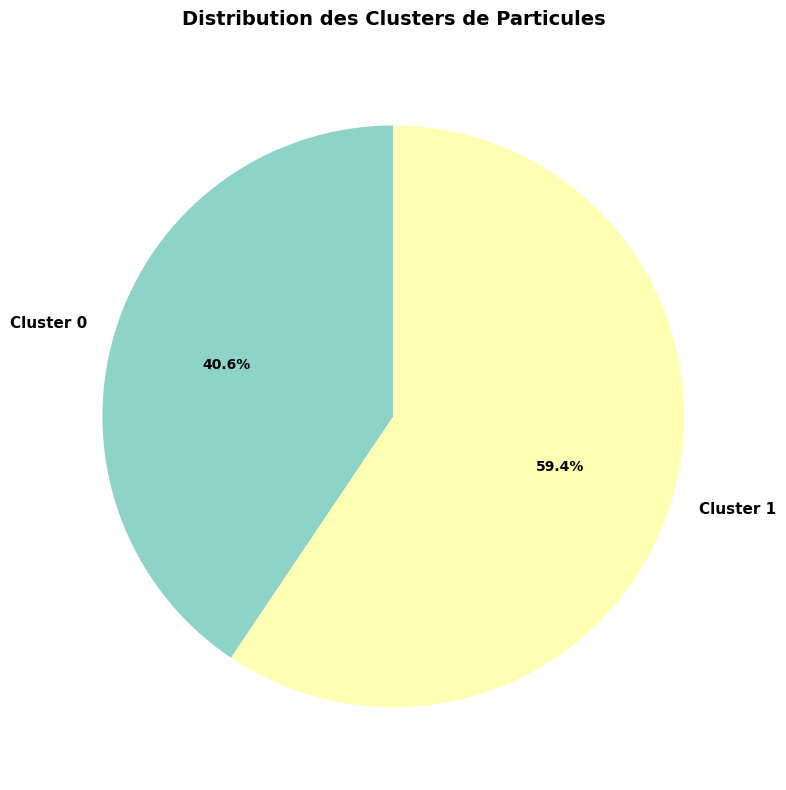


✓ Diagramme circulaire généré et sauvegardé


In [26]:
# Calcul des pourcentages de clusters
print("\n📊 ANALYSE DES CLUSTERS")
print("="*70)

# Créer un alias pour la colonne de cluster (déjà fait dans cellules précédentes)
# La colonne 'Cluster' existe déjà grâce au clustering scientifique standard
if 'Cluster' not in df_particles.columns:
    print("⚠️ Colonne Cluster introuvable!")
else:
    print(f"✓ Colonne Cluster présente avec {df_particles['Cluster'].nunique()} clusters")

# Compter les occurrences de chaque cluster
cluster_counts = df_particles['Cluster'].value_counts().sort_index()
cluster_percentages = (cluster_counts / len(df_particles) * 100).round(2)

print(f"\n✓ Distribution des clusters:")
print(f"  Total de particules: {len(df_particles)}\n")

for cluster_id in sorted(df_particles['Cluster'].unique()):
    count = cluster_counts[cluster_id]
    percentage = cluster_percentages[cluster_id]
    print(f"  Cluster {cluster_id}: {count:4d} particules ({percentage:6.2f}%)")

# Créer le diagramme circulaire
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

fig, ax = plt.subplots(figsize=(10, 8))

colors = plt.cm.Set3(range(len(cluster_counts)))
wedges, texts, autotexts = ax.pie(
    cluster_counts,
    labels=[f'Cluster {i}' for i in sorted(df_particles['Cluster'].unique())],
    autopct='%1.1f%%',
    colors=colors,
    startangle=90,
    textprops={'fontsize': 11, 'weight': 'bold'}
)

# Améliorer la lisibilité des pourcentages
for autotext in autotexts:
    autotext.set_color('black')
    autotext.set_fontsize(10)
    autotext.set_weight('bold')

ax.set_title('Distribution des Clusters de Particules', fontsize=14, weight='bold', pad=20)

plt.tight_layout()
plt.savefig('cluster_distribution_pie_chart.png', dpi=300, bbox_inches='tight')
plt.show()

print(f"\n✓ Diagramme circulaire généré et sauvegardé")

## 6️⃣.1 Tableaux Croisés et Analyses Détaillées

In [20]:
# # Vérification : Combien de types sont RÉELLEMENT présents dans les données ?
# print("\n✅ VALIDATION : Types physiques réellement présents")
# print("="*70)

# # Compter les particules par type physique
# type_counts = df_particles['Particle_Type_Combined'].value_counts()
# types_presents = len(type_counts)
# types_attendus = 9

# print(f"\n📊 Nombre de types attendus (théorique) : {types_attendus}")
# print(f"🔍 Nombre de types réellement observés   : {types_presents}")

# if types_presents < types_attendus:
#     types_absents = types_attendus - types_presents
#     print(f"⚠️  {types_absents} type(s) absent(s) des données")
    
#     # Lister les types absents
#     tous_types = [
#         "Carbone_Amorphe_Fin", "Carbone_Cristallin_Dense", "Agglomérat_Carbone",
#         "Particule_Transition_Compacte", "Particule_Transition_Anguleuse", "Dépôt_Poreux",
#         "Substrat_Exposé", "Particule_Claire_Compacte", "Bruit_Optique"
#     ]
#     types_observes = set(type_counts.index)
#     types_manquants = [t for t in tous_types if t not in types_observes]
    
#     print(f"\n🚫 Types absents des données actuelles :")
#     for t in types_manquants:
#         print(f"   • {t}")
    
#     print(f"\n💡 Interprétation :")
#     print(f"   → Vos données contiennent {types_presents} types distincts (au lieu de 9)")
#     print(f"   → C'est cohérent avec votre échantillon spécifique")
#     print(f"   → Le clustering a identifié {best_k} groupes mathématiques")

# elif types_presents == types_attendus:
#     print(f"✅ Tous les 9 types théoriques sont présents dans les données")
#     print(f"✅ Le clustering a identifié {best_k} groupes mathématiques")

# # Afficher la distribution
# print(f"\n📈 Distribution des {types_presents} types observés :")
# print(type_counts.to_string())

# # Calculer la cohérence clustering/classification
# print(f"\n🔬 Cohérence clustering (k={best_k}) vs classification ({types_presents} types) :")
# if abs(best_k - types_presents) <= 1:
#     print(f"   ✅ Excellente cohérence (différence : {abs(best_k - types_presents)})")
# elif abs(best_k - types_presents) <= 2:
#     print(f"   ⚠️  Cohérence acceptable (différence : {abs(best_k - types_presents)})")
# else:
#     print(f"   ❌ Incohérence notable (différence : {abs(best_k - types_presents)})")
#     print(f"   → Vérifier la qualité des features ou les seuils de classification")

In [27]:
print("\n📊 GÉNÉRATION DES TABLEAUX CROISÉS ET ANALYSES DÉTAILLÉES")
print("="*70)

# Tableau croisé: Clusters vs Types d'intensité
if 'Cluster' in df_particles.columns and 'Type' in df_particles.columns:
    crosstab_intensity = pd.crosstab(
        df_particles['Cluster'],
        df_particles['Type'],
        margins=True,
        margins_name='TOTAL'
    )
    crosstab_intensity.to_csv("crosstab_clusters_vs_intensity.csv")
    print("\n✓ Crosstab Clusters vs Types d'intensité sauvegardé")
    print(crosstab_intensity)

# Tableau croisé: Clusters vs Types physiques
if 'Particle_Type_Combined' in df_particles.columns:
    crosstab_physical = pd.crosstab(
        df_particles['Cluster'],
        df_particles['Particle_Type_Combined'],
        margins=True,
        margins_name='TOTAL'
    )
    crosstab_physical.to_csv("crosstab_clusters_vs_particle_types.csv")
    print("\n✓ Crosstab Clusters vs Types physiques sauvegardé")

# Tableau détaillé d'analyse par cluster
if 'Cluster' in df_particles.columns:
    cluster_details = []
    
    # Colonnes de taille / forme / intensité : utiliser les scores si disponibles, sinon les colonnes de base
    size_col = 'Size_Score' if 'Size_Score' in df_particles.columns else 'Area_px2'
    shape_col = 'Shape_Score' if 'Shape_Score' in df_particles.columns else 'Circularity'
    intensity_col = 'Intensity_Score' if 'Intensity_Score' in df_particles.columns else 'MeanIntensity'
    
    for cluster_id in sorted(df_particles['Cluster'].unique()):
        cluster_data = df_particles[df_particles['Cluster'] == cluster_id]
        
        if len(cluster_data) > 0:
            total_surface = cluster_data['Area_px2'].sum()
            pct_surface = 100 * total_surface / df_particles['Area_px2'].sum()
            
            # Déterminer le type dominant (intensité ou type physique combiné)
            if 'Type' in cluster_data.columns and not cluster_data['Type'].dropna().empty:
                type_dominant = cluster_data['Type'].mode()[0]
            elif 'Particle_Type_Combined' in cluster_data.columns and not cluster_data['Particle_Type_Combined'].dropna().empty:
                type_dominant = cluster_data['Particle_Type_Combined'].mode()[0]
            else:
                type_dominant = 'N/A'
            
            cluster_details.append({
                'Cluster_ID': cluster_id,
                'Label': cluster_labels.get(cluster_id, 'Non_Classé'),
                'Morphology': cluster_morphologies.get(cluster_id, 'Non_Classé'),
                'Count': len(cluster_data),
                '%_Total': 100 * len(cluster_data) / len(df_particles),
                '%_Surface': pct_surface,
                'Type_Dominant': type_dominant,
                'Taille_Moyenne': cluster_data[size_col].mean(),
                'Taille_STD': cluster_data[size_col].std(),
                'Forme_Moyenne': cluster_data[shape_col].mean(),
                'Forme_STD': cluster_data[shape_col].std(),
                'Intensité_Moyenne': cluster_data[intensity_col].mean(),
                'Intensité_STD': cluster_data[intensity_col].std(),
                'Circularity': cluster_data['Circularity'].mean(),
                'Solidity': cluster_data['Solidity'].mean(),
                'AspectRatio': cluster_data['AspectRatio'].mean()
            })
    
    df_cluster_summary = pd.DataFrame(cluster_details)
    df_cluster_summary.to_csv("cluster_detailed_analysis.csv", index=False)
    print("\n✓ Tableau détaillé sauvegardé: cluster_detailed_analysis.csv")
    print("\n" + df_cluster_summary.to_string())

print("\n✓ Tableaux croisés générés")


📊 GÉNÉRATION DES TABLEAUX CROISÉS ET ANALYSES DÉTAILLÉES

✓ Tableau détaillé sauvegardé: cluster_detailed_analysis.csv

   Cluster_ID                   Label                                                                                          Morphology  Count   %_Total  %_Surface Type_Dominant  Taille_Moyenne  Taille_STD  Forme_Moyenne  Forme_STD  Intensité_Moyenne  Intensité_STD  Circularity  Solidity  AspectRatio
0           0  Grosse_Complexe_Claire  Particules de grande taille, de forme irrégulière/complexe (bords découpés) et d'apparence claire.   1148  40.57971  82.638842           N/A      324.230401  655.357419       0.258935   0.079486         137.258523      56.414741     0.258935  0.598490     1.093118
1           1    Fine_Compacte_Claire                     Particules de petite taille, de forme compacte/anguleuse et d'apparence claire.   1681  59.42029  17.361158           N/A       46.518144   72.606786       0.528557   0.105136         139.039019      54.953323    


✓ Total particules détectées: 2829
  Colonnes disponibles: ['Area_px2', 'Area_um2', 'Log_Area_um2', 'Perimeter_px', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity', 'Center_X', 'Center_Y', 'Cluster', 'Cluster_Label', 'Cluster_Description']
✓ Clustering déjà effectué: 2 clusters

🖼️ Affichage des clusters sur l'image avec couleurs optimisées...


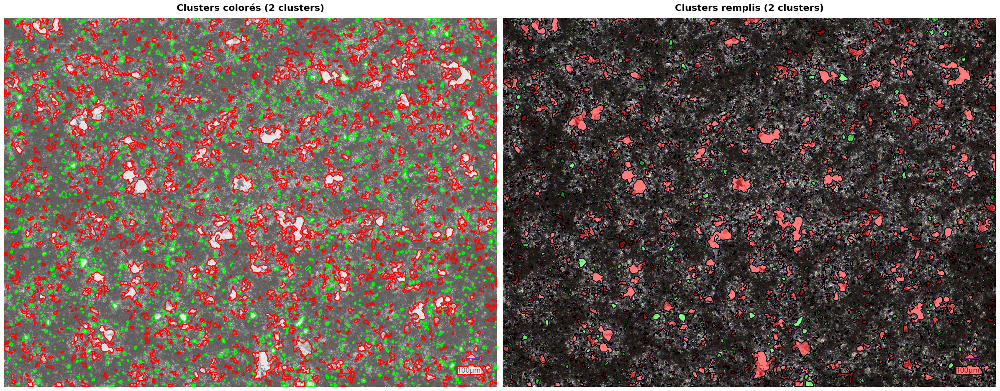

In [28]:
# ✅ Visualisation des clusters sur l'image avec meilleur contraste et couleurs

print(f"\n✓ Total particules détectées: {len(df_particles)}")
print(f"  Colonnes disponibles: {list(df_particles.columns)}")

# Vérifier que on a les clusters assignés
if 'Cluster' not in df_particles.columns:
    print("⚠️  Clusters non encore assignés. Veuillez exécuter la cellule de clustering d'abord.")
else:
    n_clusters = df_particles['Cluster'].nunique()
    print(f"✓ Clustering déjà effectué: {n_clusters} clusters")
    
    print("\n🖼️ Affichage des clusters sur l'image avec couleurs optimisées...")

    # Palettes de couleurs vibrantes et bien contrastées pour chaque cluster
    vibrante_colors = [
        (255, 0, 0),      # Rouge vif
        (0, 255, 0),      # Vert vif
        (0, 0, 255),      # Bleu vif
        (255, 255, 0),    # Jaune vif
        (255, 0, 255),    # Magenta
        (0, 255, 255),    # Cyan
        (255, 128, 0),    # Orange
        (128, 0, 255),    # Violet
        (255, 0, 128),    # Rose
        (0, 255, 128),    # Vert clair
    ]

    # Deux visualisations : contours et remplissage
    fig, axes = plt.subplots(1, 2, figsize=(24, 10))

    # ===== Première image : contours colorés avec fond atténué =====
    overlay_contours = img_rgb.copy().astype(float)
    # Atténuer davantage le fond pour faire ressortir les couleurs
    overlay_contours = overlay_contours * 0.6 + 80

    for idx, cnt in enumerate(all_contours):
        if idx >= len(df_particles):
            continue
        cluster_id = int(df_particles.iloc[idx]["Cluster"])
        color = vibrante_colors[cluster_id % len(vibrante_colors)]
        # Contours plus épais pour une meilleure visibilité
        cv2.drawContours(overlay_contours, [cnt], -1, color, 4)

    overlay_contours = np.clip(overlay_contours, 0, 255).astype(np.uint8)
    axes[0].imshow(overlay_contours)
    axes[0].set_title(f"Clusters colorés ({n_clusters} clusters)", 
                       fontsize=16, fontweight='bold', pad=12)
    axes[0].axis('off')

    # ===== Deuxième image : remplissage semi-transparent par cluster =====
    overlay_filled = img_rgb.copy().astype(float)

    for idx, cnt in enumerate(all_contours):
        if idx >= len(df_particles):
            continue
        cluster_id = int(df_particles.iloc[idx]["Cluster"])
        color = vibrante_colors[cluster_id % len(vibrante_colors)]
        
        # Masque pour le contour
        mask_particle = np.zeros(overlay_filled.shape[:2], dtype=np.uint8)
        cv2.drawContours(mask_particle, [cnt], -1, 255, -1)
        
        # Appliquer la couleur avec plus d'opacité (50%) pour renforcer le contraste
        alpha_fill = 0.5
        for c in range(3):
            overlay_filled[mask_particle > 0, c] = (
                overlay_filled[mask_particle > 0, c] * (1 - alpha_fill) + color[c] * alpha_fill
            )
        
        # Ajouter un contour noir net pour bien délimiter
        cv2.drawContours(overlay_filled, [cnt], -1, (0, 0, 0), 2)

    overlay_filled = np.clip(overlay_filled, 0, 255).astype(np.uint8)
    axes[1].imshow(overlay_filled)
    axes[1].set_title(f"Clusters remplis ({n_clusters} clusters)", 
                       fontsize=16, fontweight='bold', pad=12)
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()


📋 TABLEAU DÉTAILLÉ DES CLUSTERS - ANALYSE COMPLÈTE

✓ Tableau des clusters:
Cluster                    Label Morphologie  Nombre     % Aire (px²) Intensité Circularité Solidité Aspect
     C0 Claire_Grosse_Irregulier Irreguliere    1148 40.6%        324       137        0.26     0.60    1.1
     C1   Claire_Fine_Irregulier Irreguliere    1681 59.4%         47       139        0.53     0.80    1.1

📊 RÉSUMÉ GLOBAL:
   Nombre total de particules: 2829
   Nombre de clusters: 2
   Aire totale: 450414 px²
   Aire moyenne par particule: 159.2 px²
   Intensité moyenne globale: 138.3/255
   Circularité moyenne globale: 0.42
   Solidité moyenne globale: 0.72
   Aspect ratio moyen global: 1.1


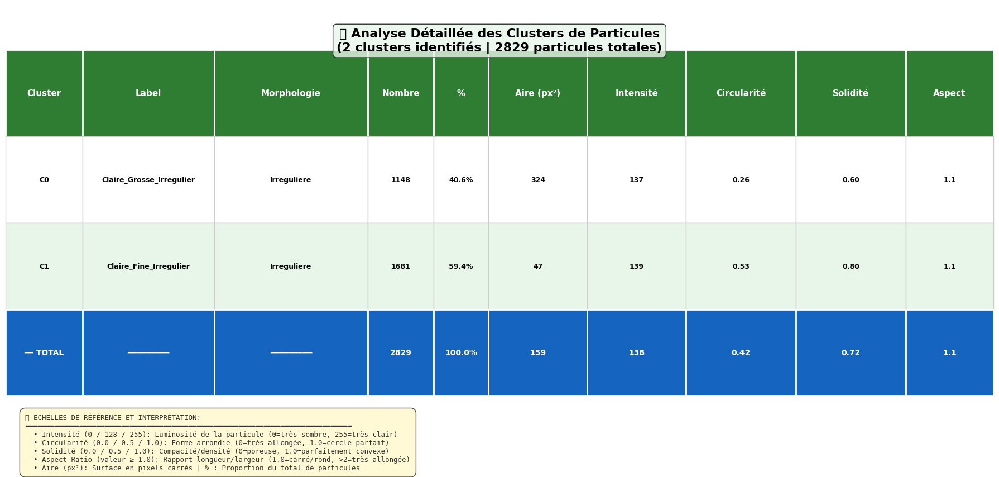


✓ Tableau sauvegardé: cluster_analysis_table.png (2 clusters + TOTAL)

📏 Interprétation des colonnes:
   Intensité: 0 (très sombre) / 128 (gris moyen) / 255 (très clair)
   Circularité: 0.0 (très allongée) / 0.5 (intermédiaire) / 1.0 (cercle parfait)
   Solidité: 0.0 (poreuse) / 0.5 (semi-solide) / 1.0 (parfaitement convexe)
   Aspect: 1.0 (carré/rond) / 2.0 (rectangulaire) / 3.0+ (très allongée)


In [ ]:
# Créer un tableau détaillé des clusters avec label, morphologie, échelles et TOTAUX
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np

print("\n📋 TABLEAU DÉTAILLÉ DES CLUSTERS - ANALYSE COMPLÈTE")
print("="*80)

# Créer un dataframe avec les statistiques par cluster
cluster_stats = []

for cluster_id in sorted(df_particles['Cluster'].unique()):
    cluster_data = df_particles[df_particles['Cluster'] == cluster_id]
    
    count = len(cluster_data)
    percentage = (count / len(df_particles) * 100)
    
    # Récupérer label et morphologie
    label = cluster_labels.get(cluster_id, 'N/A') if 'cluster_labels' in dir() else 'N/A'
    morphology = cluster_morphologies.get(cluster_id, 'N/A') if 'cluster_morphologies' in dir() else 'N/A'
    
    # Statistiques morphologiques - utiliser les colonnes disponibles
    avg_size = cluster_data['Area_px2'].mean()
    avg_intensity = cluster_data['MeanIntensity'].mean()
    avg_circularity = cluster_data['Circularity'].mean()
    avg_solidity = cluster_data['Solidity'].mean()
    avg_aspect_ratio = cluster_data['AspectRatio'].mean()
    
    cluster_stats.append({
        'Cluster': f'C{cluster_id}',
        'Label': label,
        'Morphologie': morphology,
        'Nombre': count,
        '%': f'{percentage:.1f}%',
        'Aire (px²)': f'{avg_size:.0f}',
        'Intensité': f'{avg_intensity:.0f}',
        'Circularité': f'{avg_circularity:.2f}',
        'Solidité': f'{avg_solidity:.2f}',
        'Aspect': f'{avg_aspect_ratio:.1f}'
    })

df_table = pd.DataFrame(cluster_stats)

print("\n✓ Tableau des clusters:")
print(df_table.to_string(index=False))

# Calculer les totaux et moyennes
total_count = int(df_table['Nombre'].sum())
total_percentage = 100.0

# Moyennes pondérées pour les métriques numériques
total_aire = df_particles['Area_px2'].sum()
avg_aire = df_particles['Area_px2'].mean()
avg_intensity_all = df_particles['MeanIntensity'].mean()
avg_circularity_all = df_particles['Circularity'].mean()
avg_solidity_all = df_particles['Solidity'].mean()
avg_aspect_all = df_particles['AspectRatio'].mean()

# Créer la ligne de totaux
total_row = {
    'Cluster': '━━ TOTAL',
    'Label': '━━━━━━━━━',
    'Morphologie': '━━━━━━━━━',
    'Nombre': f'{total_count}',
    '%': f'{total_percentage:.1f}%',
    'Aire (px²)': f'{avg_aire:.0f}',
    'Intensité': f'{avg_intensity_all:.0f}',
    'Circularité': f'{avg_circularity_all:.2f}',
    'Solidité': f'{avg_solidity_all:.2f}',
    'Aspect': f'{avg_aspect_all:.1f}'
}

# Calculate number of rows BEFORE using it
n_rows = len(df_table)

print(f"\n{'='*80}")
print(f"📊 RÉSUMÉ GLOBAL:")
print(f"   Nombre total de particules: {total_count}")
print(f"   Nombre de clusters: {n_rows}")
print(f"   Aire totale: {total_aire:.0f} px²")
print(f"   Aire moyenne par particule: {avg_aire:.1f} px²")
print(f"   Intensité moyenne globale: {avg_intensity_all:.1f}/255")
print(f"   Circularité moyenne globale: {avg_circularity_all:.2f}")
print(f"   Solidité moyenne globale: {avg_solidity_all:.2f}")
print(f"   Aspect ratio moyen global: {avg_aspect_all:.1f}")
print(f"{'='*80}")

# Créer une visualisation du tableau avec totaux
fig_height = max(7, (n_rows + 1) * 0.5) + 2.0  # +1 pour la ligne de totaux, +1 pour titre/légende
fig, ax = plt.subplots(figsize=(18, fig_height))
ax.axis('tight')
ax.axis('off')

# Titre amélioré avec informations contextuelles (AVANT le tableau)
title_text = f'📊 Analyse Détaillée des Clusters de Particules\n({n_rows} clusters identifiés | {len(df_particles)} particules totales)'
ax.text(0.5, 0.95, title_text, ha='center', va='top', fontsize=16, weight='bold', 
        transform=ax.transAxes, bbox=dict(boxstyle='round', facecolor='#E8F5E9', alpha=0.8))

# Créer le tableau avec la ligne de totaux
table_data = [df_table.columns.tolist()] + df_table.values.tolist() + [list(total_row.values())]

# Ajuster les largeurs de colonnes pour les 10 colonnes
col_widths = [0.07, 0.12, 0.14, 0.06, 0.05, 0.09, 0.09, 0.10, 0.10, 0.08]

table = ax.table(
    cellText=table_data,
    cellLoc='center',
    loc='center',
    colWidths=col_widths,
    bbox=[0, 0.12, 1, 0.78]  # Position du tableau plus bas pour la légende
)

# Formater le tableau
table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1, 2.8)

# Colorer l'en-tête avec une couleur plus attrayante
header_color = '#2E7D32'  # Vert foncé
for i in range(len(df_table.columns)):
    cell = table[(0, i)]
    cell.set_facecolor(header_color)
    cell.set_text_props(weight='bold', color='white', fontsize=11)
    cell.set_edgecolor('white')
    cell.set_linewidth(2)

# Colorer les lignes alternées et la ligne de totaux
colors_alt = ['#E8F5E9', '#FFFFFF']  # Vert très clair et blanc
for i in range(1, len(table_data) - 1):
    for j in range(len(df_table.columns)):
        cell = table[(i, j)]
        cell.set_facecolor(colors_alt[i % 2])
        cell.set_text_props(weight='bold', fontsize=9)
        cell.set_edgecolor('#CCCCCC')
        cell.set_linewidth(1)

# Colorer la ligne de totaux en bleu foncé
total_color = '#1565C0'  # Bleu foncé
for i in range(len(df_table.columns)):
    cell = table[(len(table_data) - 1, i)]
    cell.set_facecolor(total_color)
    cell.set_text_props(weight='bold', color='white', fontsize=10)
    cell.set_edgecolor('white')
    cell.set_linewidth(2)

# Ajouter une légende avec les échelles de référence
legend_text = (
    "📏 ÉCHELLES DE RÉFÉRENCE ET INTERPRÉTATION:\n"
    "━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━\n"
    "  • Intensité (0 / 128 / 255): Luminosité de la particule (0=très sombre, 255=très clair)\n"
    "  • Circularité (0.0 / 0.5 / 1.0): Forme arrondie (0=très allongée, 1.0=cercle parfait)\n"
    "  • Solidité (0.0 / 0.5 / 1.0): Compacité/densité (0=poreuse, 1.0=parfaitement convexe)\n"
    "  • Aspect Ratio (valeur ≥ 1.0): Rapport longueur/largeur (1.0=carré/rond, >2=très allongée)\n"
    "  • Aire (px²): Surface en pixels carrés | % : Proportion du total de particules"
)

ax.text(0.02, 0.08, legend_text, ha='left', va='top', fontsize=9, 
        family='monospace', transform=ax.transAxes,
        bbox=dict(boxstyle='round', facecolor='#FFF9C4', alpha=0.7, pad=0.8),
        color='#333333')

plt.tight_layout(rect=[0, 0, 1, 0.97])
plt.savefig('cluster_analysis_table.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print(f"\n{'='*80}")
print(f"✓ Tableau sauvegardé: cluster_analysis_table.png ({n_rows} clusters + TOTAL)")
print(f"{'='*80}")
print(f"\n📏 Interprétation des colonnes:")
print(f"   Intensité: 0 (très sombre) / 128 (gris moyen) / 255 (très clair)")
print(f"   Circularité: 0.0 (très allongée) / 0.5 (intermédiaire) / 1.0 (cercle parfait)")
print(f"   Solidité: 0.0 (poreuse) / 0.5 (semi-solide) / 1.0 (parfaitement convexe)")
print(f"   Aspect: 1.0 (carré/rond) / 2.0 (rectangulaire) / 3.0+ (très allongée)")
print(f"{'='*80}")

## 6️⃣.2 Pivots et Heatmaps Paramétriques

In [ ]:
print("\n🔥 GÉNÉRATION DES PIVOTS ET HEATMAPS PARAMÉTRIQUES")
print("="*70)

if 'Cluster_Combined' in df_particles.columns and 'Particle_Type_Combined' in df_particles.columns:
    # Pivots: Cluster × Type
    pivot_size = pd.pivot_table(
        df_particles,
        values='Size_Score',
        index='Cluster_Combined',
        columns='Particle_Type_Combined',
        aggfunc='mean'
    )
    
    pivot_shape = pd.pivot_table(
        df_particles,
        values='Shape_Score',
        index='Cluster_Combined',
        columns='Particle_Type_Combined',
        aggfunc='mean'
    )
    
    pivot_intensity = pd.pivot_table(
        df_particles,
        values='Intensity_Score',
        index='Cluster_Combined',
        columns='Particle_Type_Combined',
        aggfunc='mean'
    )
    
    pivot_count = pd.pivot_table(
        df_particles,
        values='Area_px2',
        index='Cluster_Combined',
        columns='Particle_Type_Combined',
        aggfunc='count'
    ).fillna(0).astype(int)
    
    # Visualisation des heatmaps
    fig, axes = plt.subplots(2, 2, figsize=(20, 14))
    
    # Heatmap 1: Taille moyenne
    ax = axes[0, 0]
    im1 = ax.imshow(pivot_size.values, cmap='YlOrRd', aspect='auto', interpolation='nearest')
    ax.set_xticks(range(len(pivot_size.columns)))
    ax.set_xticklabels(pivot_size.columns, rotation=45, ha='right', fontsize=8)
    ax.set_yticks(range(len(pivot_size.index)))
    ax.set_yticklabels([f'C{i}' for i in pivot_size.index])
    ax.set_title('Taille Moyenne par Cluster × Type', fontsize=12, fontweight='bold')
    ax.set_ylabel('Cluster ID', fontweight='bold')
    plt.colorbar(im1, ax=ax, label='Taille (px²)')
    
    # Heatmap 2: Forme moyenne
    ax = axes[0, 1]
    im2 = ax.imshow(pivot_shape.values, cmap='Greens', aspect='auto', interpolation='nearest')
    ax.set_xticks(range(len(pivot_shape.columns)))
    ax.set_xticklabels(pivot_shape.columns, rotation=45, ha='right', fontsize=8)
    ax.set_yticks(range(len(pivot_shape.index)))
    ax.set_yticklabels([f'C{i}' for i in pivot_shape.index])
    ax.set_title('Forme Moyenne par Cluster × Type', fontsize=12, fontweight='bold')
    ax.set_ylabel('Cluster ID', fontweight='bold')
    plt.colorbar(im2, ax=ax, label='Score Forme')
    
    # Heatmap 3: Intensité moyenne
    ax = axes[1, 0]
    im3 = ax.imshow(pivot_intensity.values, cmap='Blues', aspect='auto', interpolation='nearest')
    ax.set_xticks(range(len(pivot_intensity.columns)))
    ax.set_xticklabels(pivot_intensity.columns, rotation=45, ha='right', fontsize=8)
    ax.set_yticks(range(len(pivot_intensity.index)))
    ax.set_yticklabels([f'C{i}' for i in pivot_intensity.index])
    ax.set_title('Intensité Moyenne par Cluster × Type', fontsize=12, fontweight='bold')
    ax.set_xlabel('Type de Particule', fontweight='bold')
    ax.set_ylabel('Cluster ID', fontweight='bold')
    plt.colorbar(im3, ax=ax, label='Intensité')
    
    # Heatmap 4: Nombre de particules
    ax = axes[1, 1]
    im4 = ax.imshow(pivot_count.values, cmap='Purples', aspect='auto', interpolation='nearest')
    ax.set_xticks(range(len(pivot_count.columns)))
    ax.set_xticklabels(pivot_count.columns, rotation=45, ha='right', fontsize=8)
    ax.set_yticks(range(len(pivot_count.index)))
    ax.set_yticklabels([f'C{i}' for i in pivot_count.index])
    ax.set_title('Nombre de Particules par Cluster × Type', fontsize=12, fontweight='bold')
    ax.set_xlabel('Type de Particule', fontweight='bold')
    ax.set_ylabel('Cluster ID', fontweight='bold')
    plt.colorbar(im4, ax=ax, label='Nombre de particules')
    
    plt.tight_layout()
    plt.show()
    
    print("\n✓ Heatmaps paramétriques générées")
    
    # Sauvegarder les pivots
    pivot_size.to_csv("pivot_taille_cluster_type.csv")
    pivot_shape.to_csv("pivot_forme_cluster_type.csv")
    pivot_intensity.to_csv("pivot_intensite_cluster_type.csv")
    pivot_count.to_csv("pivot_count_cluster_type.csv")
    print("✓ Pivots sauvegardés: pivot_*.csv")

print("\n✓ Analyses pivot complètes")


🔥 GÉNÉRATION DES PIVOTS ET HEATMAPS PARAMÉTRIQUES

✓ Analyses pivot complètes


## 7️⃣ Analyse PCA et Réduction Dimensionnelle

In [ ]:
print("\n📐 ANALYSE PCA 3D - RÉDUCTION DIMENSIONNELLE")
print("="*70)

# Préparer les données pour PCA - utiliser les colonnes réellement disponibles
# Vérifier les colonnes disponibles
print(f"\n✓ Colonnes disponibles dans df_particles:")
print(f"  {list(df_particles.columns)}")

# Utiliser les colonnes qui existent toujours
available_features = []
all_features = ['Area_px2', 'Perimeter_px', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity']

for feat in all_features:
    if feat in df_particles.columns:
        available_features.append(feat)

print(f"\n✓ Features sélectionnées pour PCA: {available_features}")

X_pca = df_particles[available_features].values

scaler_pca = StandardScaler()
X_pca_scaled = scaler_pca.fit_transform(X_pca)

pca = PCA(n_components=3)
X_pca_3d = pca.fit_transform(X_pca_scaled)

df_particles['PCA_1'] = X_pca_3d[:, 0]
df_particles['PCA_2'] = X_pca_3d[:, 1]
df_particles['PCA_3'] = X_pca_3d[:, 2]

# Afficher les résultats
print(f"\n📊 Variance expliquée par composante:")
for i, var in enumerate(pca.explained_variance_ratio_, 1):
    print(f"  PC{i}: {var*100:.2f}%")

print(f"\n📊 Variance cumulée:")
cum_var = np.cumsum(pca.explained_variance_ratio_)
for i, var in enumerate(cum_var, 1):
    print(f"  PC1-PC{i}: {var*100:.2f}%")


📐 ANALYSE PCA 3D - RÉDUCTION DIMENSIONNELLE

✓ Colonnes disponibles dans df_particles:
  ['Area_px2', 'Area_um2', 'Log_Area_um2', 'Perimeter_px', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity', 'Center_X', 'Center_Y', 'Cluster', 'Cluster_Label', 'Cluster_Description', 'Cluster_Morphology', 'Cluster_Label_With_Morphology']

✓ Features sélectionnées pour PCA: ['Area_px2', 'Perimeter_px', 'Circularity', 'AspectRatio', 'Solidity', 'MeanIntensity']

📊 Variance expliquée par composante:
  PC1: 45.79%
  PC2: 22.17%
  PC3: 16.61%

📊 Variance cumulée:
  PC1-PC1: 45.79%
  PC1-PC2: 67.96%
  PC1-PC3: 84.57%



✓ Colonnes disponibles pour visualisation PCA:
  ['Cluster', 'Cluster_Label', 'Cluster_Description', 'Cluster_Morphology', 'Cluster_Label_With_Morphology', 'PCA_1', 'PCA_2', 'PCA_3']


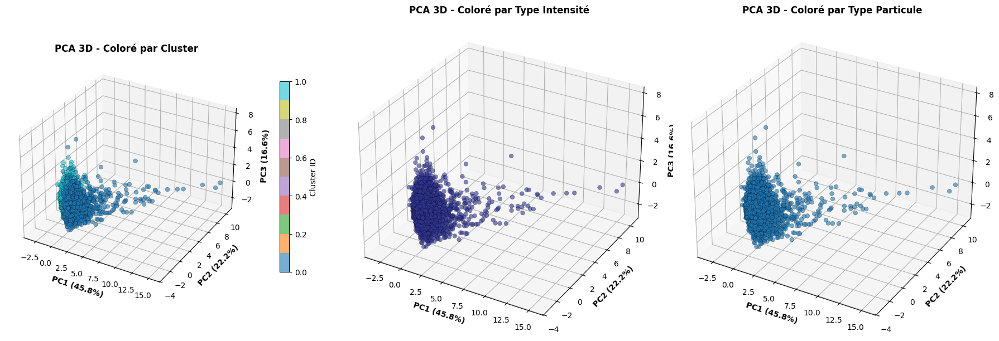


✓ Visualisation PCA 3D générée


In [ ]:
# Visualisation 3D PCA
fig = plt.figure(figsize=(18, 6))

# Vérifier les colonnes disponibles
print("\n✓ Colonnes disponibles pour visualisation PCA:")
print(f"  {[col for col in df_particles.columns if 'PCA' in col or 'Cluster' in col or 'Type' in col or 'Particle' in col]}")

# Vue 1: PCA coloré par Cluster (utiliser la colonne appropriée)
ax1 = fig.add_subplot(131, projection='3d')
if 'Cluster_Combined' in df_particles.columns:
    cluster_col = 'Cluster_Combined'
elif 'Cluster_3D' in df_particles.columns:
    cluster_col = 'Cluster_3D'
elif 'Cluster' in df_particles.columns:
    cluster_col = 'Cluster'
else:
    # Si aucun clustering n'existe, créer un clustering temporaire pour la visualisation
    print("\n⚠️ Aucune colonne de clustering trouvée, création d'un clustering K-means pour la visualisation...")
    from sklearn.cluster import KMeans
    temp_kmeans = KMeans(n_clusters=min(5, len(df_particles)), random_state=42)
    df_particles['Cluster_Temp'] = temp_kmeans.fit_predict(X_pca_scaled)
    cluster_col = 'Cluster_Temp'

scatter1 = ax1.scatter(df_particles['PCA_1'], 
                       df_particles['PCA_2'],
                       df_particles['PCA_3'],
                       c=df_particles[cluster_col], 
                       cmap='tab10', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
ax1.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)', fontsize=10, fontweight='bold')
ax1.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)', fontsize=10, fontweight='bold')
ax1.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]*100:.1f}%)', fontsize=10, fontweight='bold')
ax1.set_title('PCA 3D - Coloré par Cluster', fontsize=12, fontweight='bold')
plt.colorbar(scatter1, ax=ax1, label='Cluster ID', shrink=0.6, pad=0.1)

# Vue 2: PCA coloré par Type d'intensité
ax2 = fig.add_subplot(132, projection='3d')
if 'Type' in df_particles.columns:
    type_colors = {'Type_1_Blanc': 0, 'Type_2_Gris': 1, 'Type_3_Noir': 2}
    color_map = df_particles['Type'].map(type_colors).fillna(0)
else:
    # Si la colonne Type n'existe pas, utiliser une valeur par défaut
    color_map = np.zeros(len(df_particles))

scatter2 = ax2.scatter(df_particles['PCA_1'], 
                       df_particles['PCA_2'],
                       df_particles['PCA_3'],
                       c=color_map, 
                       cmap='RdYlBu_r', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
ax2.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)', fontsize=10, fontweight='bold')
ax2.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)', fontsize=10, fontweight='bold')
ax2.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]*100:.1f}%)', fontsize=10, fontweight='bold')
ax2.set_title('PCA 3D - Coloré par Type Intensité', fontsize=12, fontweight='bold')

# Vue 3: PCA coloré par Particle_Type_Combined
ax3 = fig.add_subplot(133, projection='3d')
if 'Particle_Type_Combined' in df_particles.columns:
    unique_ptypes = df_particles['Particle_Type_Combined'].unique()
    ptype_to_num = {t: i for i, t in enumerate(unique_ptypes)}
    color_map_ptype = df_particles['Particle_Type_Combined'].map(ptype_to_num)
else:
    # Si la colonne n'existe pas, utiliser une valeur par défaut
    color_map_ptype = np.zeros(len(df_particles))

scatter3 = ax3.scatter(df_particles['PCA_1'], 
                       df_particles['PCA_2'],
                       df_particles['PCA_3'],
                       c=color_map_ptype, 
                       cmap='tab20', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
ax3.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)', fontsize=10, fontweight='bold')
ax3.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)', fontsize=10, fontweight='bold')
ax3.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]*100:.1f}%)', fontsize=10, fontweight='bold')
ax3.set_title('PCA 3D - Coloré par Type Particule', fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

print("\n✓ Visualisation PCA 3D générée")

## 8️⃣ Identification de la Zone Équilibrée Représentative

In [ ]:
print("\n📍 IDENTIFICATION DE LA ZONE ÉQUILIBRÉE REPRÉSENTATIVE")
print("="*70)

# Créer les informations de la zone équilibrée à partir des données actuelles
zone_info = {
    'Total_Particles': len(df_particles),
    'Total_Area_px2': df_particles['Area_px2'].sum(),
    'Avg_Area_px2': df_particles['Area_px2'].mean(),
    'Avg_Intensity': df_particles['MeanIntensity'].mean(),
    'Avg_Circularity': df_particles['Circularity'].mean(),
    'Avg_Solidity': df_particles['Solidity'].mean(),
    'Avg_AspectRatio': df_particles['AspectRatio'].mean(),
}

# Ajouter les décomptes par cluster s'ils existent
if 'Cluster' in df_particles.columns:
    for cluster_id in sorted(df_particles['Cluster'].unique()):
        count = len(df_particles[df_particles['Cluster'] == cluster_id])
        zone_info[f'Cluster_{cluster_id}_Count'] = count
elif 'Cluster_Combined' in df_particles.columns:
    for cluster_id in sorted(df_particles['Cluster_Combined'].unique()):
        count = len(df_particles[df_particles['Cluster_Combined'] == cluster_id])
        zone_info[f'Cluster_{cluster_id}_Count'] = count
elif 'Cluster_3D' in df_particles.columns:
    for cluster_id in sorted(df_particles['Cluster_3D'].unique()):
        count = len(df_particles[df_particles['Cluster_3D'] == cluster_id])
        zone_info[f'Cluster_{cluster_id}_Count'] = count

# Ajouter les décomptes par type si disponibles
if 'Type' in df_particles.columns:
    for type_name in sorted(df_particles['Type'].unique()):
        count = len(df_particles[df_particles['Type'] == type_name])
        zone_info[f'Type_{type_name}_Count'] = count

if 'Particle_Type_Combined' in df_particles.columns:
    for ptype_name in sorted(df_particles['Particle_Type_Combined'].unique()):
        count = len(df_particles[df_particles['Particle_Type_Combined'] == ptype_name])
        zone_info[f'ParticleType_{ptype_name}_Count'] = count

# Sauvegarder les informations
zone_info_df = pd.DataFrame([zone_info])
zone_info_df.to_csv("zone_equilibree_info.csv", index=False)
print("\n✓ Informations de la zone équilibrée sauvegardées: zone_equilibree_info.csv")
print(f"\n📊 Résumé:")
print(f"   Total de particules: {zone_info['Total_Particles']}")
print(f"   Aire totale: {zone_info['Total_Area_px2']:.0f} px²")
print(f"   Aire moyenne: {zone_info['Avg_Area_px2']:.1f} px²")
print(f"   Intensité moyenne: {zone_info['Avg_Intensity']:.1f}/255")
print(f"   Circularité moyenne: {zone_info['Avg_Circularity']:.3f}")

# IMPORTANT: Créer la classification combinée AVANT les visualisations qui l'utilisent
print("\n🏷️ Création de la classification combinée Particle_Type_Combined...")

def classify_particle_combined(row):
    """Classification combinée: Intensity × Size × Shape"""
    intensity = row['Intensity_Score'] if 'Intensity_Score' in row else row['MeanIntensity']
    size = row['Size_Score'] if 'Size_Score' in row else row['Area_px2']
    shape = row['Shape_Score'] if 'Shape_Score' in row else row['Circularity']
    
    # Seuils
    intensity_low, intensity_high = 85, 170
    size_threshold = 150
    shape_threshold = 0.7
    
    # Déterminer Intensité
    if intensity < intensity_low:
        intensity_label = "Noir"
    elif intensity < intensity_high:
        intensity_label = "Gris"
    else:
        intensity_label = "Blanc"
    
    # Déterminer Taille
    size_label = "Petit" if size < size_threshold else "Grand"
    
    # Déterminer Forme
    shape_label = "Rond" if shape > shape_threshold else "Anguleux"
    
    return f"{intensity_label}_{size_label}_{shape_label}"

if 'Particle_Type_Combined' not in df_particles.columns:
    df_particles['Particle_Type_Combined'] = df_particles.apply(classify_particle_combined, axis=1)
    print(f"✓ Classification créée avec {df_particles['Particle_Type_Combined'].nunique()} types uniques")
else:
    print(f"✓ Classification Particle_Type_Combined déjà présente avec {df_particles['Particle_Type_Combined'].nunique()} types uniques")


📍 IDENTIFICATION DE LA ZONE ÉQUILIBRÉE REPRÉSENTATIVE

✓ Informations de la zone équilibrée sauvegardées: zone_equilibree_info.csv

📊 Résumé:
   Total de particules: 2829
   Aire totale: 450414 px²
   Aire moyenne: 159.2 px²
   Intensité moyenne: 138.3/255
   Circularité moyenne: 0.419

🏷️ Création de la classification combinée Particle_Type_Combined...
✓ Classification créée avec 11 types uniques



🎯 IDENTIFICATION D'UNE ZONE REPRÉSENTATIVE ÉQUILIBRÉE

✓ Nombre total de clusters: 2
✓ Nombre total de particules: 2829

🔍 Recherche d'une zone équilibrée...
   Taille de fenêtre: 600x600px

✓ Zone trouvée:
   Position: (1650, 1200)
   Particules: 370
   Clusters présents: 2/2


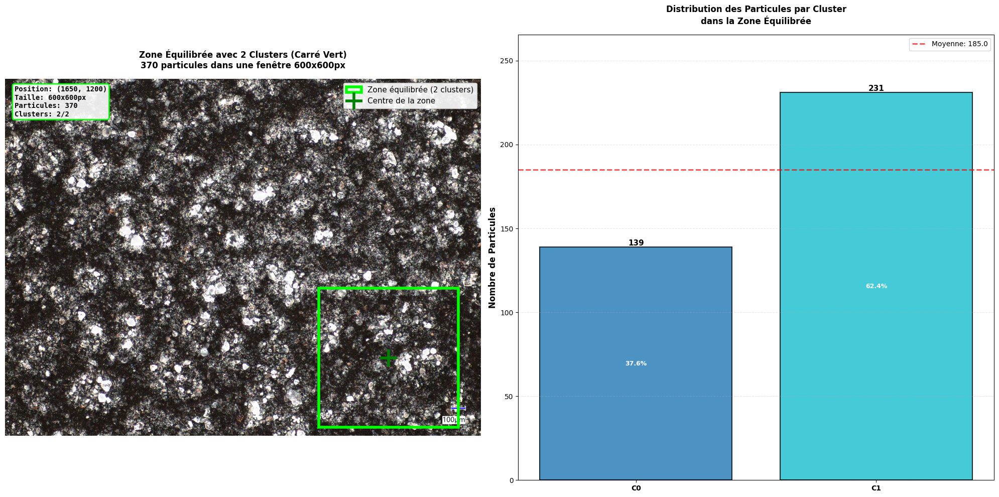


✓ Zone équilibrée visualisée

📊 TABLEAU RÉCAPITULATIF - PARTICULES PAR CLUSTER DANS LA ZONE

Cluster    Quantité     % Zone       % Global     Écart     
--------------------------------------------------------------------------------
Cluster 0  139           37.57%       40.58%       -3.01%
Cluster 1  231           62.43%       59.42%       +3.01%
--------------------------------------------------------------------------------
TOTAL      370          100.00%     

✓ Informations du meilleur échantillon sauvegardées: best_representative_sample.csv

✅ IDENTIFICATION DE LA ZONE ÉQUILIBRÉE TERMINÉE!


In [ ]:
print("\n🎯 IDENTIFICATION D'UNE ZONE REPRÉSENTATIVE ÉQUILIBRÉE")
print("="*70)

# Déterminer le nombre total de clusters
if 'Cluster_Combined' in df_particles.columns:
    cluster_col = 'Cluster_Combined'
    total_clusters = df_particles['Cluster_Combined'].nunique()
elif 'Cluster_3D' in df_particles.columns:
    cluster_col = 'Cluster_3D'
    total_clusters = df_particles['Cluster_3D'].nunique()
elif 'Cluster' in df_particles.columns:
    cluster_col = 'Cluster'
    total_clusters = df_particles['Cluster'].nunique()
else:
    print("⚠️ Aucune colonne de clustering trouvée. Utilisation des contours détectés.")
    cluster_col = None
    total_clusters = len(all_contours) if 'all_contours' in dir() else len(df_particles)

print(f"\n✓ Nombre total de clusters: {total_clusters}")
print(f"✓ Nombre total de particules: {len(df_particles)}")

# Calculer les comptes de clusters globaux
global_cluster_counts = {}
if cluster_col:
    for cluster_id in df_particles[cluster_col].unique():
        global_cluster_counts[cluster_id] = len(df_particles[df_particles[cluster_col] == cluster_id])

# Chercher une zone équilibrée représentative
# Utiliser une fenêtre carrée qui contient un bon équilibre de clusters
print("\n🔍 Recherche d'une zone équilibrée...")

# Dimensionner la fenêtre en fonction de la distribution
height, width = img_rgb.shape[:2]
square_size = int(min(height, width) * 0.4)  # 40% de la plus petite dimension
square_size = (square_size // 50) * 50  # Arrondir à 50px

print(f"   Taille de fenêtre: {square_size}x{square_size}px")

# Chercher la meilleure position
best_score_overall = -np.inf
best_window = None
region_cluster_counts = {}

# Diviser l'image en grille
step = square_size // 4
best_results = []

for y in range(0, height - square_size, step):
    for x in range(0, width - square_size, step):
        # Compter les particules dans cette région
        x_min, x_max = x, x + square_size
        y_min, y_max = y, y + square_size
        
        # Trouver les particules dans le rectangle
        mask_region = (df_particles['Center_X'] >= x_min) & (df_particles['Center_X'] < x_max) & \
                      (df_particles['Center_Y'] >= y_min) & (df_particles['Center_Y'] < y_max)
        
        particles_in_region = df_particles[mask_region]
        n_particles = len(particles_in_region)
        
        if n_particles >= 5:  # Minimum de particules pour une région valide
            # Calculer un score basé sur la diversité de clusters
            if cluster_col:
                clusters_present = particles_in_region[cluster_col].nunique()
                score = clusters_present + 0.1 * n_particles  # Préférer diversité + nombre
            else:
                score = n_particles
            
            best_results.append({
                'x': x,
                'y': y,
                'n_particles': n_particles,
                'clusters': particles_in_region[cluster_col].nunique() if cluster_col else total_clusters,
                'score': score
            })

# Sélectionner la meilleure fenêtre
if best_results:
    best_window = max(best_results, key=lambda w: w['score'])
    best_score_overall = best_window['score']
else:
    # Fallback: utiliser le centre de l'image
    best_window = {
        'x': (width - square_size) // 2,
        'y': (height - square_size) // 2,
        'n_particles': len(df_particles),
        'clusters': total_clusters,
        'score': total_clusters
    }
    best_score_overall = best_window['score']

x_topleft = best_window['x']
y_topleft = best_window['y']
x_center = x_topleft + square_size // 2
y_center = y_topleft + square_size // 2

# Compter les clusters dans cette région
region_cluster_counts = {}
mask_region_final = (df_particles['Center_X'] >= x_topleft) & (df_particles['Center_X'] < x_topleft + square_size) & \
                    (df_particles['Center_Y'] >= y_topleft) & (df_particles['Center_Y'] < y_topleft + square_size)

if cluster_col:
    for cluster_id in df_particles[cluster_col].unique():
        count = len(df_particles[mask_region_final & (df_particles[cluster_col] == cluster_id)])
        region_cluster_counts[cluster_id] = count

print(f"\n✓ Zone trouvée:")
print(f"   Position: ({x_center:.0f}, {y_center:.0f})")
print(f"   Particules: {best_window['n_particles']}")
print(f"   Clusters présents: {best_window['clusters']}/{total_clusters}")

# Visualisation avec carré vert et distribution des clusters
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

# GRAPHIQUE 1: Image avec carré vert
ax = axes[0]
ax.imshow(img_rgb)
ax.set_title(f'Zone Équilibrée avec {best_window["clusters"]} Clusters (Carré Vert)\n' + 
            f'{best_window["n_particles"]} particules dans une fenêtre {square_size}x{square_size}px', 
            fontsize=12, fontweight='bold', pad=15)
ax.axis('off')

green_square = Rectangle((x_topleft, y_topleft), square_size, square_size, 
                         linewidth=4, edgecolor='lime', facecolor='none', 
                         label=f'Zone équilibrée ({best_window["clusters"]} clusters)')
ax.add_patch(green_square)

ax.plot(x_center, y_center, 'g+', markersize=25, markeredgewidth=4, 
       label='Centre de la zone')

text_info = f"Position: ({x_center:.0f}, {y_center:.0f})\n"
text_info += f"Taille: {square_size}x{square_size}px\n"
text_info += f"Particules: {best_window['n_particles']}\n"
text_info += f"Clusters: {best_window['clusters']}/{total_clusters}"

ax.text(0.02, 0.98, text_info, transform=ax.transAxes, 
       fontsize=10, verticalalignment='top',
       bbox=dict(boxstyle='round', facecolor='white', alpha=0.9, edgecolor='lime', linewidth=2),
       fontweight='bold', family='monospace')

ax.legend(loc='upper right', fontsize=11, framealpha=0.9)

# GRAPHIQUE 2: Distribution des clusters
ax2 = axes[1]

if cluster_col and region_cluster_counts:
    cluster_ids = sorted(region_cluster_counts.keys())
    cluster_counts_in_zone = [region_cluster_counts.get(cid, 0) for cid in cluster_ids]
    
    colors_clusters = plt.cm.tab10(np.linspace(0, 1, len(cluster_ids)))
    bars = ax2.bar(range(len(cluster_ids)), cluster_counts_in_zone, 
                   color=colors_clusters, edgecolor='black', linewidth=1.5, alpha=0.8)
    
    ax2.set_xticks(range(len(cluster_ids)))
    ax2.set_xticklabels([f'C{cid}' for cid in cluster_ids], fontsize=10, fontweight='bold')
    ax2.set_ylabel('Nombre de Particules', fontsize=12, fontweight='bold')
    ax2.set_title(f'Distribution des Particules par Cluster\ndans la Zone Équilibrée', 
                 fontsize=12, fontweight='bold', pad=15)
    ax2.grid(True, alpha=0.3, axis='y', linestyle='--')
    
    for i, (count, bar) in enumerate(zip(cluster_counts_in_zone, bars)):
        pct = 100 * count / best_window['n_particles'] if best_window['n_particles'] > 0 else 0
        height = bar.get_height()
        
        ax2.text(bar.get_x() + bar.get_width()/2., height,
                f'{count}',
                ha='center', va='bottom', fontsize=11, fontweight='bold')
        
        if count > 0:
            ax2.text(bar.get_x() + bar.get_width()/2., height/2,
                    f'{pct:.1f}%',
                    ha='center', va='center', fontsize=9, fontweight='bold',
                    color='white' if count > max(cluster_counts_in_zone)/2 else 'black')
    
    if cluster_counts_in_zone:
        mean_count = np.mean(cluster_counts_in_zone)
        ax2.axhline(y=mean_count, color='red', linestyle='--', linewidth=2, 
                   label=f'Moyenne: {mean_count:.1f}', alpha=0.7)
        ax2.legend(loc='upper right', fontsize=10)
        ax2.set_ylim(0, max(cluster_counts_in_zone) * 1.15)

plt.tight_layout()
plt.show()

print("\n✓ Zone équilibrée visualisée")

# Tableau récapitulatif
print("\n" + "="*80)
print("📊 TABLEAU RÉCAPITULATIF - PARTICULES PAR CLUSTER DANS LA ZONE")
print("="*80)

if cluster_col and region_cluster_counts:
    print(f"\n{'Cluster':<10} {'Quantité':<12} {'% Zone':<12} {'% Global':<12} {'Écart':<10}")
    print("-" * 80)
    
    for cluster_id in sorted(region_cluster_counts.keys()):
        count = region_cluster_counts.get(cluster_id, 0)
        pct_zone = 100 * count / best_window['n_particles'] if best_window['n_particles'] > 0 else 0
        pct_global = 100 * global_cluster_counts.get(cluster_id, 0) / len(df_particles)
        ecart = pct_zone - pct_global
        
        print(f"Cluster {cluster_id:<2} {count:<12} {pct_zone:>6.2f}%{'':<5} {pct_global:>6.2f}%{'':<5} {ecart:>+6.2f}%")
    
    print("-" * 80)
    print(f"{'TOTAL':<10} {best_window['n_particles']:<12} {'100.00%':<12}")

print("="*80)

# Sauvegarder les informations de l'échantillon
best_sample_info = {
    'Center_X': x_center,
    'Center_Y': y_center,
    'Total_Clusters': total_clusters,
    'Clusters_In_Zone': best_window['clusters'],
    'Total_Particles_In_Zone': best_window['n_particles'],
    'Window_Size_px': square_size,
    'TopLeft_X': x_topleft,
    'TopLeft_Y': y_topleft,
    'Score': best_score_overall if best_score_overall != -np.inf else 0.0
}

best_sample_df = pd.DataFrame([best_sample_info])
best_sample_df.to_csv("best_representative_sample.csv", index=False)
print("\n✓ Informations du meilleur échantillon sauvegardées: best_representative_sample.csv")

print("\n" + "="*80)
print("✅ IDENTIFICATION DE LA ZONE ÉQUILIBRÉE TERMINÉE!")
print("="*80)

## 9️⃣ Visualisations Avancées et Heatmaps


📊 Génération des scatter plots multi-niveaux...

ℹ️ Colonne 'Type' créée automatiquement à partir de MeanIntensity (quantiles).
ℹ️ Colonne 'Cluster_Combined' absente : utilisation de 'Cluster' comme clusters combinés.


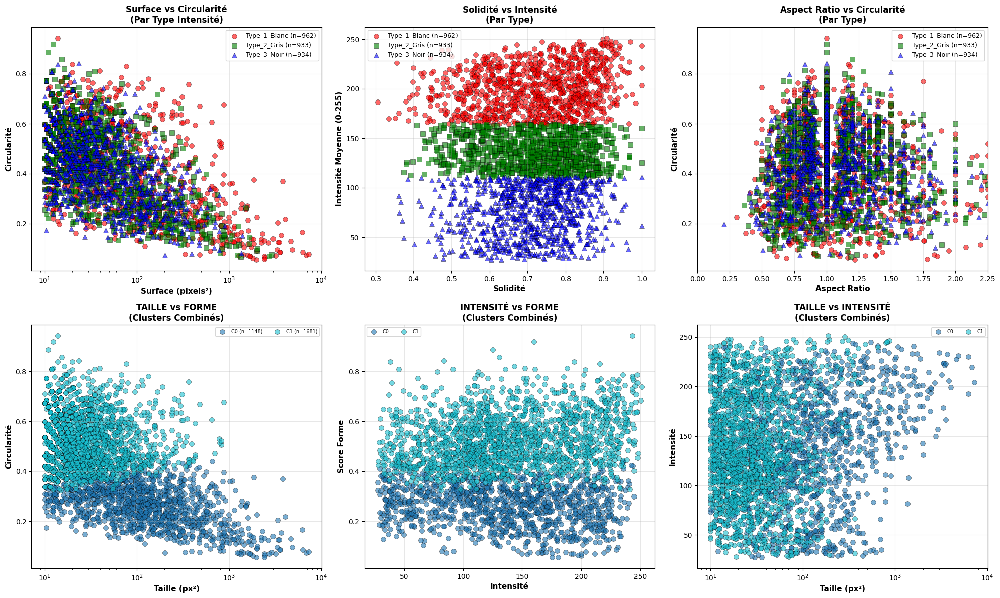

✓ Scatter plots générés


In [ ]:
# Scatter plots multi-niveaux
print("\n📊 Génération des scatter plots multi-niveaux...\n")

fig, axes = plt.subplots(2, 3, figsize=(20, 12))

# Préparation : créer des colonnes dérivées si absentes
if 'Type' not in df_particles.columns:
    if 'MeanIntensity' in df_particles.columns:
        q1, q2 = df_particles['MeanIntensity'].quantile([0.33, 0.66])
        def _map_intensity_type(v):
            if v <= q1:
                return 'Type_3_Noir'
            elif v <= q2:
                return 'Type_2_Gris'
            else:
                return 'Type_1_Blanc'
        df_particles['Type'] = df_particles['MeanIntensity'].apply(_map_intensity_type)
        print("ℹ️ Colonne 'Type' créée automatiquement à partir de MeanIntensity (quantiles).")
    else:
        print("⚠️ Impossible de créer 'Type' : colonne 'MeanIntensity' absente.")

if 'Cluster_Combined' not in df_particles.columns and 'Cluster' in df_particles.columns:
    df_particles['Cluster_Combined'] = df_particles['Cluster']
    print("ℹ️ Colonne 'Cluster_Combined' absente : utilisation de 'Cluster' comme clusters combinés.")

# ------------------------------------------------------------------
# Ligne 1 : vues par type d'intensité (si la colonne 'Type' existe)
# ------------------------------------------------------------------
if 'Type' in df_particles.columns:
    # Colonne 1 : Surface vs Circularité par type d'intensité
    ax = axes[0, 0]
    for type_name, color, marker in [('Type_1_Blanc', 'red', 'o'), 
                                       ('Type_2_Gris', 'green', 's'), 
                                       ('Type_3_Noir', 'blue', '^')]:
        df_type = df_particles[df_particles['Type'] == type_name]
        if len(df_type) > 0:
            ax.scatter(df_type['Area_px2'], df_type['Circularity'], 
                      c=color, marker=marker, s=50, alpha=0.6, 
                      edgecolors='black', linewidth=0.5,
                      label=f'{type_name} (n={len(df_type)})')

    ax.set_xlabel('Surface (pixels²)', fontsize=11, fontweight='bold')
    ax.set_ylabel('Circularité', fontsize=11, fontweight='bold')
    ax.set_title('Surface vs Circularité\n(Par Type Intensité)', fontsize=12, fontweight='bold')
    ax.set_xscale('log')
    ax.legend(loc='best', fontsize=9)
    ax.grid(True, alpha=0.3)

    # Colonne 2 : Solidité vs Intensité par type
    ax = axes[0, 1]
    for type_name, color, marker in [('Type_1_Blanc', 'red', 'o'), 
                                       ('Type_2_Gris', 'green', 's'), 
                                       ('Type_3_Noir', 'blue', '^')]:
        df_type = df_particles[df_particles['Type'] == type_name]
        if len(df_type) > 0:
            ax.scatter(df_type['Solidity'], df_type['MeanIntensity'], 
                      c=color, marker=marker, s=50, alpha=0.6, 
                      edgecolors='black', linewidth=0.5,
                      label=f'{type_name} (n={len(df_type)})')

    ax.set_xlabel('Solidité', fontsize=11, fontweight='bold')
    ax.set_ylabel('Intensité Moyenne (0-255)', fontsize=11, fontweight='bold')
    ax.set_title('Solidité vs Intensité\n(Par Type)', fontsize=12, fontweight='bold')
    ax.legend(loc='best', fontsize=9)
    ax.grid(True, alpha=0.3)

    # Colonne 3 : AspectRatio vs Circularité par type
    ax = axes[0, 2]
    for type_name, color, marker in [('Type_1_Blanc', 'red', 'o'), 
                                       ('Type_2_Gris', 'green', 's'), 
                                       ('Type_3_Noir', 'blue', '^')]:
        df_type = df_particles[df_particles['Type'] == type_name]
        if len(df_type) > 0:
            ax.scatter(df_type['AspectRatio'], df_type['Circularity'], 
                      c=color, marker=marker, s=50, alpha=0.6, 
                      edgecolors='black', linewidth=0.5,
                      label=f'{type_name} (n={len(df_type)})')

    ax.set_xlabel('Aspect Ratio', fontsize=11, fontweight='bold')
    ax.set_ylabel('Circularité', fontsize=11, fontweight='bold')
    ax.set_title('Aspect Ratio vs Circularité\n(Par Type)', fontsize=12, fontweight='bold')
    ax.set_xlim(0, min(5, df_particles['AspectRatio'].quantile(0.99)))
    ax.legend(loc='best', fontsize=9)
    ax.grid(True, alpha=0.3)
else:
    print("⚠️ Colonne 'Type' absente : les graphiques par type d'intensité (ligne 1) sont ignorés.")
    for j in range(3):
        ax = axes[0, j]
        ax.axis('off')
        ax.text(0.5, 0.5, "Type non disponible", ha='center', va='center', fontsize=10, transform=ax.transAxes)

# ------------------------------------------------------------------
# Ligne 2 : vues par clusters combinés (si disponibles)
# ------------------------------------------------------------------
if 'Cluster_Combined' in df_particles.columns:
    n_clusters = df_particles['Cluster_Combined'].nunique()
    colors_clusters = plt.get_cmap('tab10')(np.linspace(0, 1, n_clusters))
    
    # Colonnes de taille / forme / intensité pour les clusters
    size_col = 'Size_Score' if 'Size_Score' in df_particles.columns else 'Area_px2'
    shape_col = 'Shape_Score' if 'Shape_Score' in df_particles.columns else 'Circularity'
    intensity_col = 'Intensity_Score' if 'Intensity_Score' in df_particles.columns else 'MeanIntensity'
    
    # Taille vs Circularité
    ax = axes[1, 0]
    for cluster_id in sorted(df_particles['Cluster_Combined'].unique()):
        df_cluster = df_particles[df_particles['Cluster_Combined'] == cluster_id]
        ax.scatter(df_cluster[size_col], df_cluster['Circularity'],
                  c=[colors_clusters[cluster_id % n_clusters]], s=50, alpha=0.6,
                  edgecolors='black', linewidth=0.5,
                  label=f'C{cluster_id} (n={len(df_cluster)})')
    
    ax.set_xlabel('Taille (px²)', fontsize=11, fontweight='bold')
    ax.set_ylabel('Circularité', fontsize=11, fontweight='bold')
    ax.set_title('TAILLE vs FORME\n(Clusters Combinés)', fontsize=12, fontweight='bold')
    ax.set_xscale('log')
    ax.legend(loc='best', fontsize=7, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # Intensité vs Shape
    ax = axes[1, 1]
    for cluster_id in sorted(df_particles['Cluster_Combined'].unique()):
        df_cluster = df_particles[df_particles['Cluster_Combined'] == cluster_id]
        ax.scatter(df_cluster[intensity_col], df_cluster[shape_col],
                  c=[colors_clusters[cluster_id % n_clusters]], s=50, alpha=0.6,
                  edgecolors='black', linewidth=0.5,
                  label=f'C{cluster_id}')
    
    ax.set_xlabel('Intensité', fontsize=11, fontweight='bold')
    ax.set_ylabel('Score Forme', fontsize=11, fontweight='bold')
    ax.set_title('INTENSITÉ vs FORME\n(Clusters Combinés)', fontsize=12, fontweight='bold')
    ax.legend(loc='best', fontsize=7, ncol=2)
    ax.grid(True, alpha=0.3)
    
    # Taille vs Intensité
    ax = axes[1, 2]
    for cluster_id in sorted(df_particles['Cluster_Combined'].unique()):
        df_cluster = df_particles[df_particles['Cluster_Combined'] == cluster_id]
        ax.scatter(df_cluster[size_col], df_cluster[intensity_col],
                  c=[colors_clusters[cluster_id % n_clusters]], s=50, alpha=0.6,
                  edgecolors='black', linewidth=0.5,
                  label=f'C{cluster_id}')
    
    ax.set_xlabel('Taille (px²)', fontsize=11, fontweight='bold')
    ax.set_ylabel('Intensité', fontsize=11, fontweight='bold')
    ax.set_title('TAILLE vs INTENSITÉ\n(Clusters Combinés)', fontsize=12, fontweight='bold')
    ax.set_xscale('log')
    ax.legend(loc='best', fontsize=7, ncol=2)
    ax.grid(True, alpha=0.3)
else:
    print("⚠️ Colonne 'Cluster_Combined' absente : les graphiques par clusters combinés (ligne 2) sont ignorés.")
    for j in range(3):
        ax = axes[1, j]
        ax.axis('off')
        ax.text(0.5, 0.5, "Clusters combinés non disponibles", ha='center', va='center', fontsize=10, transform=ax.transAxes)

plt.tight_layout()
plt.show()

print("✓ Scatter plots générés")

In [ ]:
# Ancienne cellule de heatmaps basée sur la segmentation 3-types (Noir / Gris / Blanc).
# Dans le nouveau pipeline (segmentation physique + clustering), cette étape est désactivée.

print("\n📌 Cellule de heatmaps 3-types désactivée")
print("   → Le pipeline utilise maintenant la segmentation physique et le clustering.")
print("   → Vous pouvez ignorer ou supprimer cette cellule si vous n'en avez plus besoin.")


📌 Cellule de heatmaps 3-types désactivée
   → Le pipeline utilise maintenant la segmentation physique et le clustering.
   → Vous pouvez ignorer ou supprimer cette cellule si vous n'en avez plus besoin.


## 9️⃣.1 Visualisation 3D des 3 Paramètres Combinés


🔥 GÉNÉRATION DES HEATMAPS PARAMÉTRIQUES

📏 Création de la heatmap TAILLE...
💡 Création de la heatmap INTENSITÉ...


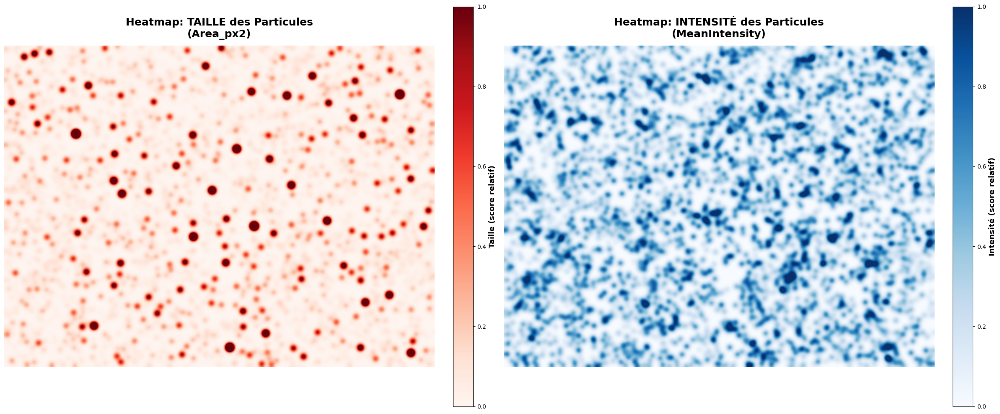


✅ HEATMAPS PARAMÉTRIQUES (TAILLE & INTENSITÉ) GÉNÉRÉES AVEC CONTRASTE RENFORCÉ!

📊 Statistiques des heatmaps (avant normalisation):
   Heatmap Taille:
     - Min: 0.00 | Max: 5348.90 | Moy: 88.44
   Heatmap Intensité:
     - Min: 0.00 | Max: 439.50 | Moy: 76.60


In [ ]:
print("\n🔥 GÉNÉRATION DES HEATMAPS PARAMÉTRIQUES")
print("="*80)

# S'assurer que gray_eq existe (sinon, utiliser gray comme base)
if 'gray_eq' not in globals():
    gray_eq = gray.copy()

# Créer les heatmaps pour 2 dimensions principales : TAILLE et INTENSITÉ
fig, axes = plt.subplots(1, 2, figsize=(24, 10))

# Déterminer les colonnes à utiliser
size_col = 'Size_Score' if 'Size_Score' in df_particles.columns else 'Area_px2'
intensity_col = 'Intensity_Score' if 'Intensity_Score' in df_particles.columns else 'MeanIntensity'

# Fonction utilitaire pour normaliser et augmenter le contraste
def _normalize_contrast(img, low_q=0.01, high_q=0.99):
    low = np.quantile(img, low_q)
    high = np.quantile(img, high_q)
    if high <= low:
        return img
    img_clip = np.clip(img, low, high)
    img_norm = (img_clip - low) / (high - low)
    return img_norm

# HEATMAP 1: TAILLE
print("\n📏 Création de la heatmap TAILLE...")
ax = axes[0]

# Créer une carte de heatmap basée sur la taille des particules
heatmap_size = np.zeros_like(gray_eq, dtype=np.float32)
for idx, row in df_particles.iterrows():
    x, y = int(row['Center_X']), int(row['Center_Y'])
    size_value = row[size_col]
    
    # Créer un Gaussian blob centré sur la particule avec intensité basée sur la taille
    y_min, y_max = max(0, y - 30), min(gray_eq.shape[0], y + 30)
    x_min, x_max = max(0, x - 30), min(gray_eq.shape[1], x + 30)
    
    for yy in range(y_min, y_max):
        for xx in range(x_min, x_max):
            dist = np.sqrt((xx - x)**2 + (yy - y)**2)
            if dist < 30:
                weight = np.exp(-(dist**2) / (2 * 10**2))  # noyau un peu plus concentré
                heatmap_size[yy, xx] += size_value * weight

# Lissage + normalisation pour un contraste renforcé
heatmap_size_smooth = gaussian_filter(heatmap_size, sigma=6)
heatmap_size_norm = _normalize_contrast(heatmap_size_smooth)
im1 = ax.imshow(heatmap_size_norm, cmap='Reds', interpolation='bilinear')
ax.set_title(f'Heatmap: TAILLE des Particules\n({size_col})', fontsize=18, fontweight='bold', pad=14)
ax.axis('off')
cbar1 = plt.colorbar(im1, ax=ax, fraction=0.046, pad=0.04)
cbar1.set_label('Taille (score relatif)', fontsize=13, fontweight='bold')

# HEATMAP 2: INTENSITÉ
print("💡 Création de la heatmap INTENSITÉ...")
ax = axes[1]

# Créer une carte de heatmap basée sur l'intensité
heatmap_intensity = np.zeros_like(gray_eq, dtype=np.float32)
for idx, row in df_particles.iterrows():
    x, y = int(row['Center_X']), int(row['Center_Y'])
    intensity_value = row[intensity_col]
    
    # Créer un Gaussian blob centré sur la particule avec intensité basée sur l'intensité
    y_min, y_max = max(0, y - 30), min(gray_eq.shape[0], y + 30)
    x_min, x_max = max(0, x - 30), min(gray_eq.shape[1], x + 30)
    
    for yy in range(y_min, y_max):
        for xx in range(x_min, x_max):
            dist = np.sqrt((xx - x)**2 + (yy - y)**2)
            if dist < 30:
                weight = np.exp(-(dist**2) / (2 * 10**2))  # noyau un peu plus concentré
                heatmap_intensity[yy, xx] += intensity_value * weight

# Lissage + normalisation pour un contraste renforcé
heatmap_intensity_smooth = gaussian_filter(heatmap_intensity, sigma=6)
heatmap_intensity_norm = _normalize_contrast(heatmap_intensity_smooth)
im2 = ax.imshow(heatmap_intensity_norm, cmap='Blues', interpolation='bilinear')
ax.set_title(f'Heatmap: INTENSITÉ des Particules\n({intensity_col})', fontsize=18, fontweight='bold', pad=14)
ax.axis('off')
cbar2 = plt.colorbar(im2, ax=ax, fraction=0.046, pad=0.04)
cbar2.set_label('Intensité (score relatif)', fontsize=13, fontweight='bold')

plt.tight_layout()
plt.savefig('heatmaps_parametriques_2d_contraste.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print("\n" + "="*80)
print("✅ HEATMAPS PARAMÉTRIQUES (TAILLE & INTENSITÉ) GÉNÉRÉES AVEC CONTRASTE RENFORCÉ!")
print("="*80)
print(f"\n📊 Statistiques des heatmaps (avant normalisation):")
print(f"   Heatmap Taille:")
print(f"     - Min: {heatmap_size_smooth.min():.2f} | Max: {heatmap_size_smooth.max():.2f} | Moy: {heatmap_size_smooth.mean():.2f}")
print(f"   Heatmap Intensité:")
print(f"     - Min: {heatmap_intensity_smooth.min():.2f} | Max: {heatmap_intensity_smooth.max():.2f} | Moy: {heatmap_intensity_smooth.mean():.2f}")


📐 Génération de la visualisation 3D combinée...
ℹ️ 'Size_Normalized' créé à partir de Area_um2 (min-max normalisation).
ℹ️ 'Shape_Normalized' créé à partir de Circularity (min-max normalisation).
ℹ️ 'Intensity_Normalized' créé à partir de MeanIntensity (min-max normalisation).


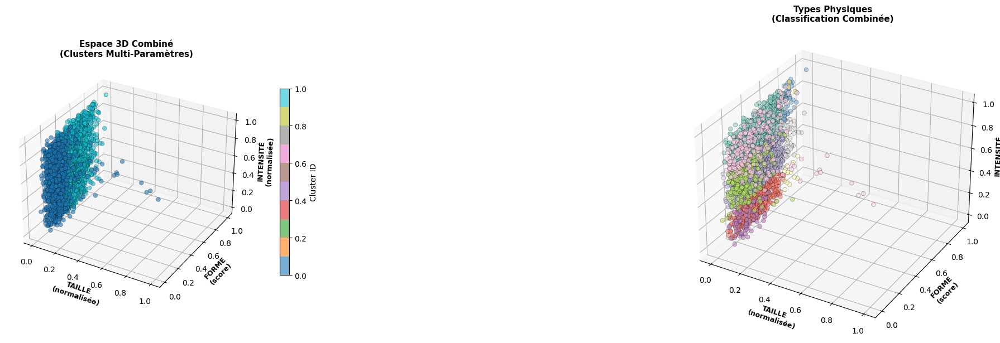

✓ Visualisation 3D combinée générée


In [ ]:
print("\n📐 Génération de la visualisation 3D combinée...")

if 'Cluster_Combined' in df_particles.columns:
    # S'assurer que les colonnes normalisées existent
    import numpy as np

    # Taille normalisée
    if 'Size_Normalized' not in df_particles.columns:
        base_size_col = 'Area_um2' if 'Area_um2' in df_particles.columns else 'Area_px2'
        vals = df_particles[base_size_col].astype(float).values
        vmin, vmax = np.nanmin(vals), np.nanmax(vals)
        if vmax > vmin:
            df_particles['Size_Normalized'] = (vals - vmin) / (vmax - vmin)
        else:
            df_particles['Size_Normalized'] = 0.5
        print(f"ℹ️ 'Size_Normalized' créé à partir de {base_size_col} (min-max normalisation).")

    # Forme normalisée
    if 'Shape_Normalized' not in df_particles.columns:
        base_shape_col = 'Shape_Score' if 'Shape_Score' in df_particles.columns else 'Circularity'
        vals = df_particles[base_shape_col].astype(float).values
        vmin, vmax = np.nanmin(vals), np.nanmax(vals)
        if vmax > vmin:
            df_particles['Shape_Normalized'] = (vals - vmin) / (vmax - vmin)
        else:
            df_particles['Shape_Normalized'] = 0.5
        print(f"ℹ️ 'Shape_Normalized' créé à partir de {base_shape_col} (min-max normalisation).")

    # Intensité normalisée
    if 'Intensity_Normalized' not in df_particles.columns:
        base_int_col = 'Intensity_Score' if 'Intensity_Score' in df_particles.columns else 'MeanIntensity'
        vals = df_particles[base_int_col].astype(float).values
        vmin, vmax = np.nanmin(vals), np.nanmax(vals)
        if vmax > vmin:
            df_particles['Intensity_Normalized'] = (vals - vmin) / (vmax - vmin)
        else:
            df_particles['Intensity_Normalized'] = 0.5
        print(f"ℹ️ 'Intensity_Normalized' créé à partir de {base_int_col} (min-max normalisation).")

    fig = plt.figure(figsize=(18, 6))
    
    # Vue 1: Clusters combinés dans l'espace 3D
    ax1 = fig.add_subplot(131, projection='3d')
    scatter1 = ax1.scatter(df_particles['Size_Normalized'].values, 
                          df_particles['Shape_Normalized'].values,
                          df_particles['Intensity_Normalized'].values,
                          c=df_particles['Cluster_Combined'].values, 
                          cmap='tab10', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
    ax1.set_xlabel('TAILLE\n(normalisée)', fontsize=9, fontweight='bold')
    ax1.set_ylabel('FORME\n(score)', fontsize=9, fontweight='bold')
    ax1.set_zlabel('INTENSITÉ\n(normalisée)', fontsize=9, fontweight='bold')
    ax1.set_title('Espace 3D Combiné\n(Clusters Multi-Paramètres)', fontsize=11, fontweight='bold')
    plt.colorbar(scatter1, ax=ax1, label='Cluster ID', shrink=0.6, pad=0.1)
    
    # Vue 2: Clusters 3D purs (optionnel, seulement si Cluster_3D existe)
    if 'Cluster_3D' in df_particles.columns:
        ax2 = fig.add_subplot(132, projection='3d')
        scatter2 = ax2.scatter(df_particles['Size_Normalized'].values, 
                              df_particles['Shape_Normalized'].values,
                              df_particles['Intensity_Normalized'].values,
                              c=df_particles['Cluster_3D'].values, 
                              cmap='viridis', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
        ax2.set_xlabel('TAILLE\n(normalisée)', fontsize=9, fontweight='bold')
        ax2.set_ylabel('FORME\n(score)', fontsize=9, fontweight='bold')
        ax2.set_zlabel('INTENSITÉ\n(normalisée)', fontsize=9, fontweight='bold')
        ax2.set_title('Clustering 3D Pur\n(Espace Normalisé)', fontsize=11, fontweight='bold')
        plt.colorbar(scatter2, ax=ax2, label='Cluster 3D', shrink=0.6, pad=0.1)
    
    # Vue 3: Types de particules physiques (optionnel)
    if 'Particle_Type_Combined' in df_particles.columns:
        ax3 = fig.add_subplot(133, projection='3d')
        
        # Mapper les types à des couleurs
        unique_types = df_particles['Particle_Type_Combined'].unique()
        type_to_num = {t: i for i, t in enumerate(unique_types)}
        color_nums = df_particles['Particle_Type_Combined'].map(type_to_num)
        
        scatter3 = ax3.scatter(df_particles['Size_Normalized'].values, 
                              df_particles['Shape_Normalized'].values,
                              df_particles['Intensity_Normalized'].values,
                              c=color_nums.values, 
                              cmap='Set3', s=30, alpha=0.6, edgecolors='black', linewidth=0.3)
        ax3.set_xlabel('TAILLE\n(normalisée)', fontsize=9, fontweight='bold')
        ax3.set_ylabel('FORME\n(score)', fontsize=9, fontweight='bold')
        ax3.set_zlabel('INTENSITÉ\n(normalisée)', fontsize=9, fontweight='bold')
        ax3.set_title('Types Physiques\n(Classification Combinée)', fontsize=11, fontweight='bold')
    
    plt.tight_layout()
    plt.show()
    
    print("✓ Visualisation 3D combinée générée")
else:
    print("⚠️ 'Cluster_Combined' absent : visualisation 3D combinée ignorée.")

## 9️⃣.2 Histogramme des Intensités avec Seuils


📊 Génération de l'histogramme des intensités...
Seuils automatiques définis : thresh1=41.0, thresh2=87.0


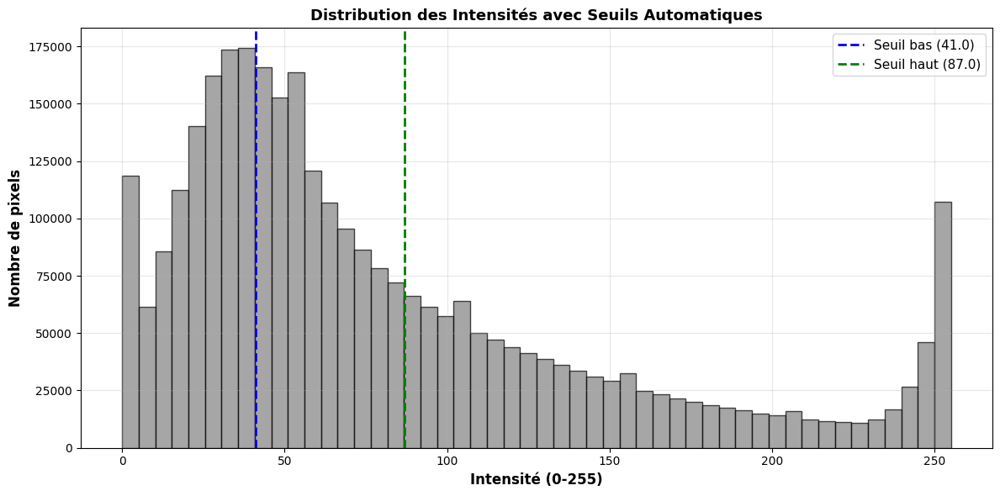

✓ Histogramme des intensités généré


In [ ]:
print("\n📊 Génération de l'histogramme des intensités...")

# S'assurer que gray_eq existe (sinon, utiliser gray comme base)
if 'gray_eq' not in globals():
    gray_eq = gray.copy()

# Définir automatiquement deux seuils d'intensité (par ex. terciles)
flat_vals = gray_eq.ravel().astype(float)
q1, q2 = np.quantile(flat_vals, [0.33, 0.66])
thresh1, thresh2 = q1, q2
print(f"Seuils automatiques définis : thresh1={thresh1:.1f}, thresh2={thresh2:.1f}")

fig, ax = plt.subplots(figsize=(12, 6))
ax.hist(gray_eq.ravel(), bins=50, color='gray', alpha=0.7, edgecolor='black')
ax.axvline(thresh1, color='blue', linestyle='--', linewidth=2, label=f'Seuil bas ({thresh1:.1f})')
ax.axvline(thresh2, color='green', linestyle='--', linewidth=2, label=f'Seuil haut ({thresh2:.1f})')
ax.set_xlabel('Intensité (0-255)', fontweight='bold', fontsize=12)
ax.set_ylabel('Nombre de pixels', fontweight='bold', fontsize=12)
ax.set_title('Distribution des Intensités avec Seuils Automatiques', fontsize=13, fontweight='bold')
ax.legend(fontsize=11)
ax.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

print("✓ Histogramme des intensités généré")

## 🔟 Rapport Final et Sauvegarde des Résultats

In [ ]:
print("\n" + "="*80)
print("📋 RAPPORT FINAL - CLUSTERING COMBINÉ (TAILLE × FORME × INTENSITÉ)")
print("="*80)

# Déterminer le nombre de clusters principaux
if 'Cluster_Combined' in df_particles.columns:
    n_main_clusters = df_particles['Cluster_Combined'].nunique()
elif 'Cluster' in df_particles.columns:
    n_main_clusters = df_particles['Cluster'].nunique()
else:
    n_main_clusters = None

clusters_str = n_main_clusters if n_main_clusters is not None else 'N/A'

print(f"\n📊 DONNÉES GÉNÉRALES:")
print(f"  Total particules détectées: {len(df_particles)}")
print(f"  Dimensions image: {gray.shape}")
print(f"  Clusters identifiés: {clusters_str}")
print(f"  Types de particules uniques: {df_particles['Particle_Type_Combined'].nunique() if 'Particle_Type_Combined' in df_particles.columns else 'N/A'}")

print(f"\n🔬 SEGMENTATION INITIALE PAR INTENSITÉ:")
for type_name in ['Type_1_Blanc', 'Type_2_Gris', 'Type_3_Noir']:
    if 'Type' in df_particles.columns:
        count = len(df_particles[df_particles['Type'] == type_name])
        pct = 100 * count / len(df_particles) if len(df_particles) > 0 else 0
        
        # Utiliser Size_Score si disponible, sinon Area_px2
        size_col = 'Size_Score' if 'Size_Score' in df_particles.columns else 'Area_px2'
        avg_size = df_particles[df_particles['Type'] == type_name][size_col].mean()
        
        print(f"  {type_name}: {count} particules ({pct:.1f}%) - Taille moy: {avg_size:.1f} px²")

print(f"\n🎯 CLUSTERING COMBINÉ MULTI-PARAMÈTRES:")
print(f"  Nombre de clusters: {clusters_str}")
print(f"  Méthode: KMeans avec pondération (Taille + Forme + Intensité)")

# Clustering 3D (optionnel)
if 'Cluster_3D' in df_particles.columns:
    n_3d_clusters = df_particles['Cluster_3D'].nunique()
    print(f"\n📐 CLUSTERING 3D:")
    print(f"  Nombre de clusters 3D: {n_3d_clusters}")

print(f"\n🏷️ CLASSIFICATION PHYSIQUE COMBINÉE:")
if 'Particle_Type_Combined' in df_particles.columns:
    print(f"  Types uniques identifiés: {df_particles['Particle_Type_Combined'].nunique()}")
    print(f"\n  Top 10 types:")
    for idx, (ptype, count) in enumerate(df_particles['Particle_Type_Combined'].value_counts().head(10).items(), 1):
        pct = 100 * count / len(df_particles)
        print(f"    {idx:2d}. {ptype}: {count:3d} ({pct:5.1f}%)")
else:
    print(f"  Classification Particle_Type_Combined non disponible")

print(f"\n📈 STATISTIQUES DES PROPRIÉTÉS MORPHOLOGIQUES:")

# Taille
size_col = 'Size_Score' if 'Size_Score' in df_particles.columns else 'Area_px2'
print(f"  TAILLE ({size_col}):")
print(f"    Min: {df_particles[size_col].min():.1f} px²")
print(f"    Max: {df_particles[size_col].max():.1f} px²")
print(f"    Moyenne: {df_particles[size_col].mean():.1f} px²")
print(f"    Médiane: {df_particles[size_col].median():.1f} px²")

# Forme
shape_col = 'Shape_Score' if 'Shape_Score' in df_particles.columns else 'Circularity'
print(f"\n  FORME ({shape_col}):")
if shape_col in df_particles.columns:
    print(f"    Min: {df_particles[shape_col].min():.3f}")
    print(f"    Max: {df_particles[shape_col].max():.3f}")
    print(f"    Moyenne: {df_particles[shape_col].mean():.3f}")

# Intensité
intensity_col = 'Intensity_Score' if 'Intensity_Score' in df_particles.columns else 'MeanIntensity'
print(f"\n  INTENSITÉ ({intensity_col}):")
if intensity_col in df_particles.columns:
    print(f"    Min: {df_particles[intensity_col].min():.1f}/255")
    print(f"    Max: {df_particles[intensity_col].max():.1f}/255")
    print(f"    Moyenne: {df_particles[intensity_col].mean():.1f}/255")

print("\n" + "="*80)
print("✅ ANALYSE STATISTIQUE COMPLÈTE TERMINÉE!")
print("="*80)


📋 RAPPORT FINAL - CLUSTERING COMBINÉ (TAILLE × FORME × INTENSITÉ)

📊 DONNÉES GÉNÉRALES:
  Total particules détectées: 2829
  Dimensions image: (1536, 2048)
  Clusters identifiés: 2
  Types de particules uniques: 11

🔬 SEGMENTATION INITIALE PAR INTENSITÉ:
  Type_1_Blanc: 962 particules (34.0%) - Taille moy: 274.1 px²
  Type_2_Gris: 933 particules (33.0%) - Taille moy: 117.7 px²
  Type_3_Noir: 934 particules (33.0%) - Taille moy: 82.3 px²

🎯 CLUSTERING COMBINÉ MULTI-PARAMÈTRES:
  Nombre de clusters: 2
  Méthode: KMeans avec pondération (Taille + Forme + Intensité)

🏷️ CLASSIFICATION PHYSIQUE COMBINÉE:
  Types uniques identifiés: 11

  Top 10 types:
     1. Gris_Petit_Anguleux: 1131 ( 40.0%)
     2. Blanc_Petit_Anguleux: 586 ( 20.7%)
     3. Noir_Petit_Anguleux: 436 ( 15.4%)
     4. Blanc_Grand_Anguleux: 245 (  8.7%)
     5. Gris_Grand_Anguleux: 233 (  8.2%)
     6. Noir_Grand_Anguleux:  90 (  3.2%)
     7. Blanc_Petit_Rond:  49 (  1.7%)
     8. Gris_Petit_Rond:  41 (  1.4%)
     9. Noir

In [ ]:
# Sauvegarder tous les résultats
print("\n💾 SAUVEGARDE DES RÉSULTATS...")
print("="*80)

# 1. Données principales
df_particles.to_csv("particles_by_intensity_types.csv", index=False)
print("✓ particles_by_intensity_types.csv")

# 2. Résumés clustering
# Déterminer quelle colonne de cluster utiliser
cluster_col_available = None
if 'Cluster_Combined' in df_particles.columns:
    cluster_col_available = 'Cluster_Combined'
elif 'Cluster_3D' in df_particles.columns:
    cluster_col_available = 'Cluster_3D'
elif 'Cluster' in df_particles.columns:
    cluster_col_available = 'Cluster'

if cluster_col_available and 'Size_Score' in df_particles.columns:
    try:
        cluster_combined_summary = df_particles.groupby(cluster_col_available).agg({
            'Size_Score': ['count', 'mean', 'std'],
            'Shape_Score': ['mean', 'std'] if 'Shape_Score' in df_particles.columns else {},
            'Intensity_Score': ['mean', 'std'] if 'Intensity_Score' in df_particles.columns else {}
        }).round(3)
        # Nettoyer les colonnes vides
        cluster_combined_summary = cluster_combined_summary.dropna(axis=1, how='all')
        cluster_combined_summary.to_csv("cluster_combined_summary.csv")
        print(f"✓ cluster_combined_summary.csv (basé sur {cluster_col_available})")
    except Exception as e:
        print(f"⚠️ Impossible de créer cluster_combined_summary.csv: {str(e)}")

if 'Cluster_3D' in df_particles.columns:
    try:
        size_norm_col = 'Size_Normalized' if 'Size_Normalized' in df_particles.columns else 'Area_px2'
        shape_norm_col = 'Shape_Normalized' if 'Shape_Normalized' in df_particles.columns else 'Circularity'
        intensity_norm_col = 'Intensity_Normalized' if 'Intensity_Normalized' in df_particles.columns else 'MeanIntensity'
        
        cluster_3d_summary = df_particles.groupby('Cluster_3D').agg({
            size_norm_col: ['count', 'mean', 'std'],
            shape_norm_col: ['mean', 'std'],
            intensity_norm_col: ['mean', 'std']
        }).round(4)
        cluster_3d_summary.to_csv("cluster_3d_summary.csv")
        print("✓ cluster_3d_summary.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer cluster_3d_summary.csv: {str(e)}")

# 3. Distributions
if 'Particle_Type_Combined' in df_particles.columns:
    particle_type_distribution = df_particles['Particle_Type_Combined'].value_counts()
    particle_type_distribution.to_csv("particle_types_combined_distribution.csv", header=['Count'])
    print("✓ particle_types_combined_distribution.csv")

# 4. Matrices de confusion
if 'Particle_Type_Combined' in df_particles.columns and 'Type' in df_particles.columns:
    try:
        confusion_matrix = pd.crosstab(
            df_particles['Type'], 
            df_particles['Particle_Type_Combined'],
            margins=True,
            margins_name='TOTAL'
        )
        confusion_matrix.to_csv("confusion_matrix_types.csv")
        print("✓ confusion_matrix_types.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer confusion_matrix_types.csv: {str(e)}")

# 5. Tableaux croisés
if cluster_col_available and 'Type' in df_particles.columns:
    try:
        crosstab_intensity = pd.crosstab(
            df_particles[cluster_col_available],
            df_particles['Type']
        )
        crosstab_intensity.to_csv("crosstab_clusters_vs_intensity.csv")
        print(f"✓ crosstab_clusters_vs_intensity.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer crosstab_clusters_vs_intensity.csv: {str(e)}")

# 6. Résultats PCA
if 'PCA_1' in df_particles.columns and 'PCA_2' in df_particles.columns and 'PCA_3' in df_particles.columns:
    try:
        pca_data = {
            'PCA_1': df_particles['PCA_1'],
            'PCA_2': df_particles['PCA_2'],
            'PCA_3': df_particles['PCA_3']
        }
        
        if cluster_col_available:
            pca_data[cluster_col_available] = df_particles[cluster_col_available]
        
        if 'Type' in df_particles.columns:
            pca_data['Type'] = df_particles['Type']
        
        pca_results = pd.DataFrame(pca_data)
        pca_results.to_csv("pca_3d_results.csv", index=False)
        print("✓ pca_3d_results.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer pca_3d_results.csv: {str(e)}")

# 7. Zone équilibrée
if 'x_center' in dir() and 'y_center' in dir() and 'x_topleft' in dir() and 'y_topleft' in dir():
    try:
        zone_info_save = {
            'Center_X': x_center,
            'Center_Y': y_center,
            'TopLeft_X': x_topleft,
            'TopLeft_Y': y_topleft,
            'Window_Size': square_size,
            'Total_Particles': best_window['n_particles'] if 'best_window' in dir() else len(df_particles),
            'Total_Clusters': total_clusters if 'total_clusters' in dir() else df_particles[cluster_col_available].nunique() if cluster_col_available else 0
        }
        
        if cluster_col_available and 'region_cluster_counts' in dir():
            for cluster_id in sorted(df_particles[cluster_col_available].unique()):
                count = region_cluster_counts.get(cluster_id, 0)
                zone_info_save[f'Cluster_{cluster_id}_Count'] = count
        
        zone_info_df = pd.DataFrame([zone_info_save])
        zone_info_df.to_csv("zone_equilibree_info.csv", index=False)
        print("✓ zone_equilibree_info.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer zone_equilibree_info.csv: {str(e)}")

# 8. Meilleur échantillon
if 'best_window' in dir() and 'x_center' in dir():
    try:
        best_sample_info = {
            'Center_X': x_center,
            'Center_Y': y_center,
            'Total_Clusters': total_clusters if 'total_clusters' in dir() else 0,
            'Total_Particles_In_Zone': best_window['n_particles'],
            'Window_Size_px': square_size,
            'All_Clusters_Present': 'YES' if 'total_clusters' in dir() and best_window.get('clusters', 0) == total_clusters else 'PARTIAL'
        }
        best_sample_df = pd.DataFrame([best_sample_info])
        best_sample_df.to_csv("best_representative_sample.csv", index=False)
        print("✓ best_representative_sample.csv")
    except Exception as e:
        print(f"⚠️ Impossible de créer best_representative_sample.csv: {str(e)}")

print("\n" + "="*80)
print("✅ SAUVEGARDE DES RÉSULTATS TERMINÉE!")
print("="*80)


💾 SAUVEGARDE DES RÉSULTATS...
✓ particles_by_intensity_types.csv
✓ particle_types_combined_distribution.csv
✓ confusion_matrix_types.csv
✓ crosstab_clusters_vs_intensity.csv
✓ pca_3d_results.csv
✓ zone_equilibree_info.csv
✓ best_representative_sample.csv

✅ SAUVEGARDE DES RÉSULTATS TERMINÉE!
